In [1]:
import os
os.environ['HDF5_USE_FILE_LOCKING'] = 'FALSE'

In [2]:
import numpy as np
import pandas as pd
import scanpy as sc
import anndata
import re

In [3]:
%matplotlib inline
import matplotlib.pyplot as plt
import seaborn as sns
from tqdm import tqdm

In [4]:
import sys
sys.path.append('../../ext/')
import codes.py_util as util
import codes.py_wknn as wknn
import codes.scarches_label_transfer as sclt

# Explore metabolic states

In [11]:
adata_dirty = sc.read_h5ad('../../data/phase3_final_0516/ZH_processed.h5ad')

In [13]:
str(list(adata_dirty.obs.columns))

"['assay_sc', 'assay_differentiation', 'assay_type_differentiation', 'bio_sample', 'cell_line', 'cell_type', 'development_stage', 'disease', 'ethnicity', 'gm', 'id', 'individual', 'organ', 'organism', 'sex', 'state_exact', 'sample_source', 'source_doi', 'suspension_type_original', 'tech_sample', 'treatment', 'assay_sc_original', 'cell_line_original', 'cell_type_original', 'development_stage_original', 'disease_original', 'ethnicity_original', 'organ_original', 'organism_original', 'sex_original', 'suspension_type', 'obs_names_original', 'organoid_age_days', 'publication', 'doi', 'batch', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'leiden_pca_unintegrated_1', 'leiden_pca_unintegrated_80', 'leiden_pca_rss_1', 'leiden_pca_rss_80', 'snapseed_pca_unintegrated_level_1', 'snapseed_pca_unintegrated_level_2', 'snapseed_pca_unintegrated_level_3', 'snapseed_pca_unintegrated_level_4', 'snapseed_

In [5]:
adata = sc.read_h5ad('../../data/phase3_final_0516/ZH_processed_cleanup.h5ad')

In [6]:
adata.obs.columns

Index(['assay_sc', 'assay_differentiation', 'assay_type_differentiation',
       'bio_sample', 'cell_line', 'cell_type', 'development_stage', 'disease',
       'ethnicity', 'gm', 'id', 'individual', 'organ', 'sex', 'state_exact',
       'sample_source', 'source_doi', 'tech_sample', 'organoid_age_days',
       'organoid_age_weeks', 'organoid_age_months', 'publication', 'doi',
       'batch', 'publication_protocol', 'suspension_type_original',
       'cell_line_original', 'cell_type_original',
       'development_stage_original', 'disease_original', 'ethnicity_original',
       'organ_original', 'organism_original', 'sex_original',
       'obs_names_original', 'n_genes_by_counts', 'log1p_n_genes_by_counts',
       'total_counts', 'log1p_total_counts', 'total_counts_mt',
       'log1p_total_counts_mt', 'pct_counts_mt', 'snapseed_level_1',
       'snapseed_level_2', 'snapseed_level_3', 'snapseed_level_4',
       'snapseed_level_5', 'annot_level_1', 'annot_level_2', 'annot_level_3',
       

In [9]:
str(list(adata.obs['publication'].unique()))

"['Andersen, 2020', 'Bhaduri, 2020', 'Birey, 2017', 'Bowles, 2021', 'Fiorenzano, 2021', 'Fleck, 2022', 'He, 2022', 'Huang, 2021', 'Kanton, 2019', 'Kelava, 2022', 'Khan, 2020', 'Miura, 2020', 'Paulsen, 2022', 'Pellegrini, 2020', 'Qian, 2020', 'Quadrato, 2023', 'Samarasinghe, 2021', 'Sawada, 2020', 'Treutlein, 2023', 'Trujillo, 2019', 'Uzquiano, 2022', 'Velasco, 2019', 'Vertesy, 2022', 'Xiang, 2019', 'Yoon, 2019', 'Marton, 2019', 'Sloan, 2017']"

## Metabolic state scores as in Uzquiano

In [22]:
msigdb_glycolysis = np.array(pd.read_csv('../../ext/HALLMARK_GLYCOLYSIS.v2023.2.Hs.tsv', sep='\t', header=None, index_col=0).loc['GENE_SYMBOLS',1].split(','))
msigdb_hypoxia = np.array(pd.read_csv('../../ext/HALLMARK_HYPOXIA.v2023.2.Hs.tsv', sep='\t', header=None, index_col=0).loc['GENE_SYMBOLS',1].split(','))
msigdb_oxidative_phosp = np.array(pd.read_csv('../../ext/HALLMARK_OXIDATIVE_PHOSPHORYLATION.v2023.2.Hs.tsv', sep='\t', header=None, index_col=0).loc['GENE_SYMBOLS',1].split(','))
[len(msigdb_glycolysis),len(msigdb_hypoxia),len(msigdb_oxidative_phosp)]

[200, 200, 200]

In [24]:
msigdb_glycolysis = np.intersect1d(msigdb_glycolysis, adata.var_names)
msigdb_hypoxia = np.intersect1d(msigdb_hypoxia, adata.var_names)
msigdb_oxidative_phosp = np.intersect1d(msigdb_oxidative_phosp, adata.var_names)
[len(msigdb_glycolysis),len(msigdb_hypoxia),len(msigdb_oxidative_phosp)]

[200, 200, 200]

In [28]:
sc.tl.score_genes(adata, msigdb_glycolysis, score_name='Hallmark_Glycolysis')
sc.tl.score_genes(adata, msigdb_hypoxia, score_name='Hallmark_Hypoxia')
sc.tl.score_genes(adata, msigdb_oxidative_phosp, score_name='Hallmark_Oxidative_Phosphorylation')

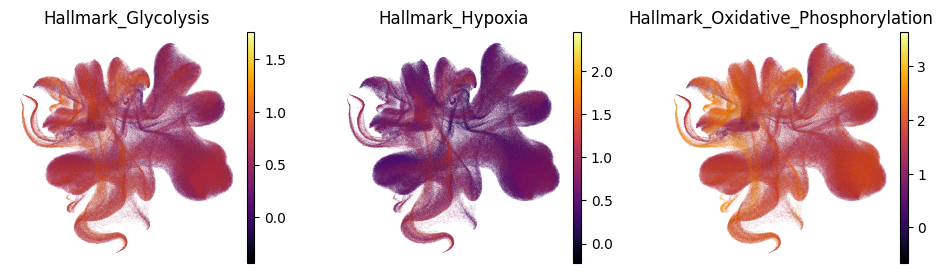

In [34]:
with plt.rc_context({'figure.figsize' : (3,3)}):
    sc.pl.embedding(adata, basis='X_umap_scpoli', color=['Hallmark_Glycolysis','Hallmark_Hypoxia','Hallmark_Oxidative_Phosphorylation'], color_map = 'inferno', ncols=3, frameon=False)

In [32]:
adata.obs[['Hallmark_Glycolysis','Hallmark_Hypoxia','Hallmark_Oxidative_Phosphorylation']].corr()

,Hallmark_Glycolysis,Hallmark_Hypoxia,Hallmark_Oxidative_Phosphorylation
Hallmark_Glycolysis,1.000000,0.733808,0.614552
Hallmark_Hypoxia,0.733808,1.000000,0.367062
Hallmark_Oxidative_Phosphorylation,0.614552,0.367062,1.000000


In [33]:
adata.obs.loc[adata.obs['annot_level_1']=='Neuron',['Hallmark_Glycolysis','Hallmark_Hypoxia','Hallmark_Oxidative_Phosphorylation']].corr()

,Hallmark_Glycolysis,Hallmark_Hypoxia,Hallmark_Oxidative_Phosphorylation
Hallmark_Glycolysis,1.000000,0.718366,0.549588
Hallmark_Hypoxia,0.718366,1.000000,0.327856
Hallmark_Oxidative_Phosphorylation,0.549588,0.327856,1.000000


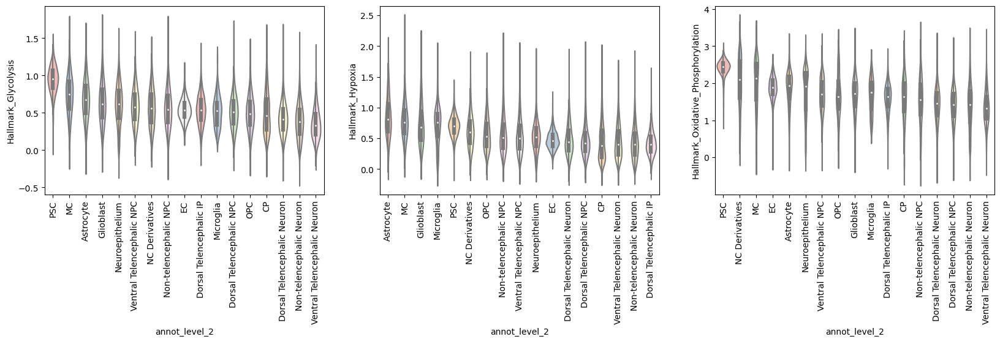

In [42]:
fig, ax = plt.subplots(1,3, figsize=(20,4))
for i in range(3):
    col = np.array(['Hallmark_Glycolysis','Hallmark_Hypoxia','Hallmark_Oxidative_Phosphorylation'])[i]
    ordered_ct = adata.obs[['annot_level_2',col]].groupby('annot_level_2').mean().sort_values(col, ascending=False).index
    sns.violinplot(x="annot_level_2", y=col, data=adata.obs, palette="Pastel1", order=ordered_ct, ax=ax[i])
    ax[i].set_xticklabels(ax[i].get_xticklabels(),rotation=90)
fig.show()

## Compare with the glycolysis scores used in the manuscript

In [45]:
glycolysis4DE = pd.read_csv('../../data/phase3_final_0516/DE_0718/obs_stress_scores_scaled.tsv.gz', sep='\t', index_col=0)
glycolysis4DE.head()

,assay_sc,assay_differentiation,assay_type_differentiation,cell_line,suspension_type,organoid_age_days,publication,batch,n_genes,neuron_subtype,publication_protocol,canonical_glycolysis_score,mitochondrial_ATP_synthesis_coupled_electron_transport_score,joint_score
homosapiens_hindbrain_2020_bdrhapsodywholetranscriptomeanalysis_andersenjimena_001_d10_1016_j_cell_2020_11_017_72,BD Rhapsody Whole Transcriptome Analysis,"Andersen, 2020 (doi: 10.1016/j.cell.2020.11.017)",guided,custom_8858-1,cell,45.0,"Andersen, 2020",homosapiens_hindbrain_2020_bdrhapsodywholetran...,1908,Medulla Neuron NT-GABA,"Andersen, 2020_Andersen, 2020 (doi: 10.1016/j....",1.107093,0.615775,0.590402
homosapiens_hindbrain_2020_bdrhapsodywholetranscriptomeanalysis_andersenjimena_001_d10_1016_j_cell_2020_11_017_79,BD Rhapsody Whole Transcriptome Analysis,"Andersen, 2020 (doi: 10.1016/j.cell.2020.11.017)",guided,custom_8858-1,cell,45.0,"Andersen, 2020",homosapiens_hindbrain_2020_bdrhapsodywholetran...,1858,Ventral Midbrain Neuron NT-VGLUT,"Andersen, 2020_Andersen, 2020 (doi: 10.1016/j....",0.902592,0.599557,0.550308
homosapiens_hindbrain_2020_bdrhapsodywholetranscriptomeanalysis_andersenjimena_001_d10_1016_j_cell_2020_11_017_83,BD Rhapsody Whole Transcriptome Analysis,"Andersen, 2020 (doi: 10.1016/j.cell.2020.11.017)",guided,custom_8858-1,cell,45.0,"Andersen, 2020",homosapiens_hindbrain_2020_bdrhapsodywholetran...,1917,Medulla Neuron NT-VGLUT,"Andersen, 2020_Andersen, 2020 (doi: 10.1016/j....",0.660512,0.692608,0.529996
homosapiens_hindbrain_2020_bdrhapsodywholetranscriptomeanalysis_andersenjimena_001_d10_1016_j_cell_2020_11_017_85,BD Rhapsody Whole Transcriptome Analysis,"Andersen, 2020 (doi: 10.1016/j.cell.2020.11.017)",guided,custom_8858-1,cell,45.0,"Andersen, 2020",homosapiens_hindbrain_2020_bdrhapsodywholetran...,1789,Medulla Neuron NT-VGLUT,"Andersen, 2020_Andersen, 2020 (doi: 10.1016/j....",0.734523,0.738733,0.554243
homosapiens_hindbrain_2020_bdrhapsodywholetranscriptomeanalysis_andersenjimena_001_d10_1016_j_cell_2020_11_017_86,BD Rhapsody Whole Transcriptome Analysis,"Andersen, 2020 (doi: 10.1016/j.cell.2020.11.017)",guided,custom_8858-1,cell,45.0,"Andersen, 2020",homosapiens_hindbrain_2020_bdrhapsodywholetran...,1891,Pons Neuron NT-SER,"Andersen, 2020_Andersen, 2020 (doi: 10.1016/j....",1.218892,0.687463,0.627516


In [47]:
from scipy.stats import pearsonr, spearmanr
shared_cells = np.intersect1d(glycolysis4DE.index, adata.obs_names)
[ pearsonr(glycolysis4DE.loc[shared_cells, 'canonical_glycolysis_score'], adata.obs['Hallmark_Glycolysis'][shared_cells]),
  spearmanr(glycolysis4DE.loc[shared_cells, 'canonical_glycolysis_score'], adata.obs['Hallmark_Glycolysis'][shared_cells]) ]

[PearsonRResult(statistic=0.5592106960067307, pvalue=0.0),
 SignificanceResult(statistic=0.5580273741134765, pvalue=0.0)]

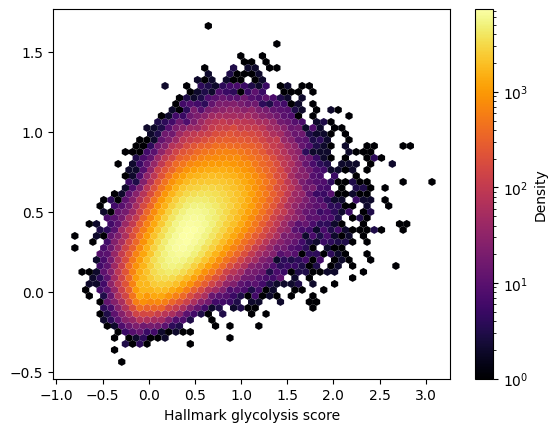

In [55]:
plt.hexbin(glycolysis4DE.loc[shared_cells, 'canonical_glycolysis_score'], adata.obs['Hallmark_Glycolysis'][shared_cells], gridsize=50, cmap='inferno', edgecolors='none', bins='log')
plt.xlabel('Canonical glycolysis score')
plt.xlabel('Hallmark glycolysis score')
plt.colorbar(label='Density')
plt.show()

In [60]:
import statsmodels.formula.api as smf
dat = pd.concat([glycolysis4DE.loc[shared_cells, 'canonical_glycolysis_score'], adata.obs['Hallmark_Glycolysis'][shared_cells]], axis=1)
results = smf.ols('canonical_glycolysis_score ~ Hallmark_Glycolysis', data=dat).fit()
print(results.summary())

                                OLS Regression Results                                
Dep. Variable:     canonical_glycolysis_score   R-squared:                       0.313
Model:                                    OLS   Adj. R-squared:                  0.313
Method:                         Least Squares   F-statistic:                 3.898e+05
Date:                        Thu, 04 Apr 2024   Prob (F-statistic):               0.00
Time:                                11:30:39   Log-Likelihood:                -71545.
No. Observations:                      856616   AIC:                         1.431e+05
Df Residuals:                          856614   BIC:                         1.431e+05
Df Model:                                   1                                         
Covariance Type:                    nonrobust                                         
                          coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------

In [91]:
shared_cN = np.intersect1d(shared_cells, adata.obs_names[adata.obs['annot_level_2']=='Dorsal Telencephalic Neuron'])
dat = pd.concat([glycolysis4DE.loc[shared_cN, 'canonical_glycolysis_score'], adata.obs.loc[shared_cN, ['Hallmark_Glycolysis','publication','publication_protocol']]], axis=1)
ds = dat['publication_protocol'].value_counts().loc[lambda x: x>20].index
dat = dat.loc[np.isin(dat['publication_protocol'], ds),:]
dat['publication_protocol'] = dat['publication_protocol'].cat.remove_unused_categories()
dat.head()

,canonical_glycolysis_score,Hallmark_Glycolysis,publication,publication_protocol
homosapiens_None_2017_bdrhapsodywholetranscriptomeanalysis_bireyfikri_001_d10_1038_nature22330_1001,0.819711,0.325604,"Birey, 2017","Birey, 2017: Pasca, 2015 (doi: 10.1038/nmeth.3..."
homosapiens_None_2017_bdrhapsodywholetranscriptomeanalysis_bireyfikri_001_d10_1038_nature22330_1002,0.831841,0.477139,"Birey, 2017","Birey, 2017: Pasca, 2015 (doi: 10.1038/nmeth.3..."
homosapiens_None_2017_bdrhapsodywholetranscriptomeanalysis_bireyfikri_001_d10_1038_nature22330_10021,0.748410,0.406475,"Birey, 2017","Birey, 2017: Birey, 2017 (doi: 10.1038/nature2..."
homosapiens_None_2017_bdrhapsodywholetranscriptomeanalysis_bireyfikri_001_d10_1038_nature22330_1005,0.331497,0.457138,"Birey, 2017","Birey, 2017: Pasca, 2015 (doi: 10.1038/nmeth.3..."
homosapiens_None_2017_bdrhapsodywholetranscriptomeanalysis_bireyfikri_001_d10_1038_nature22330_10061,0.601288,0.381145,"Birey, 2017","Birey, 2017: Birey, 2017 (doi: 10.1038/nature2..."


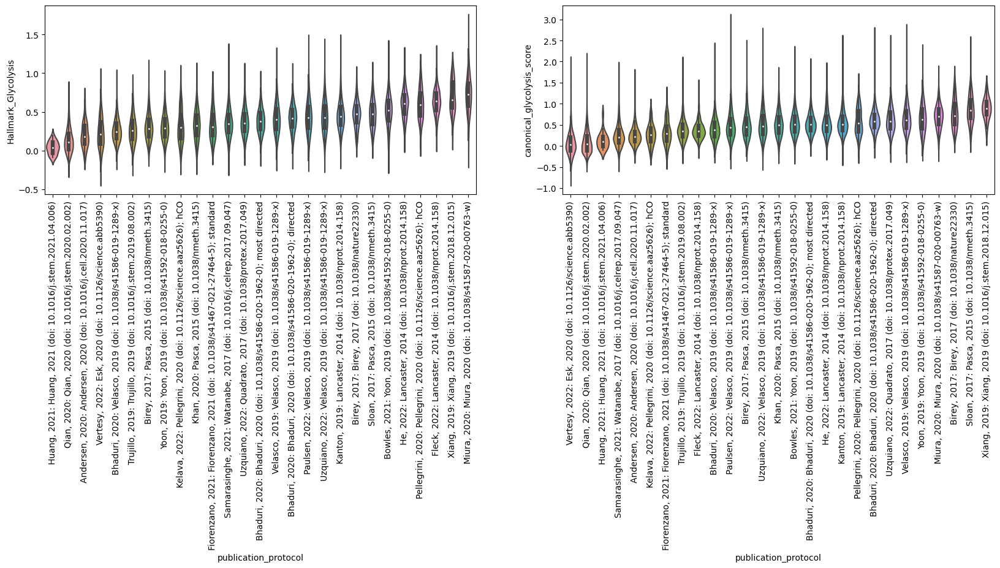

In [92]:
fig, ax = plt.subplots(1,2, figsize=(20,4))
ordered_ds = dat[['publication_protocol','Hallmark_Glycolysis']].groupby('publication_protocol').mean().sort_values('Hallmark_Glycolysis', ascending=True).index
sns.violinplot(x="publication_protocol", y='Hallmark_Glycolysis', data=dat, order=ordered_ds, ax=ax[0])
ax[0].set_xticklabels(ax[0].get_xticklabels(),rotation=90)
ordered_ds = dat[['publication_protocol','canonical_glycolysis_score']].groupby('publication_protocol').mean().sort_values('canonical_glycolysis_score', ascending=True).index
sns.violinplot(x="publication_protocol", y='canonical_glycolysis_score', data=dat, order=ordered_ds, ax=ax[1])
ax[1].set_xticklabels(ax[1].get_xticklabels(),rotation=90)
fig.show()

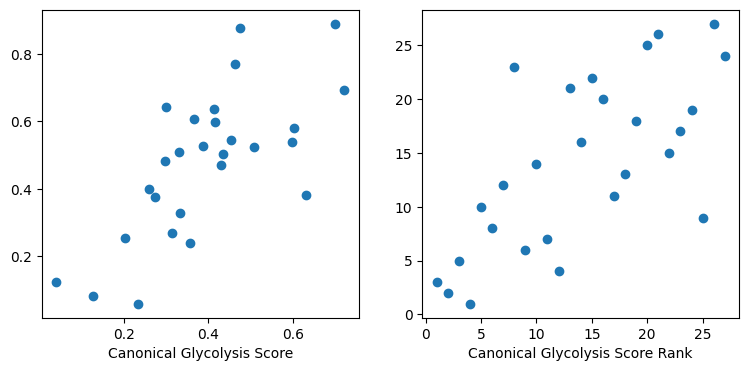

In [93]:
fig, ax = plt.subplots(1,2,figsize=(9,4))
ax[0].scatter(dat[['publication_protocol','Hallmark_Glycolysis']].groupby('publication_protocol').mean()['Hallmark_Glycolysis'],
              dat[['publication_protocol','canonical_glycolysis_score']].groupby('publication_protocol').mean()['canonical_glycolysis_score'])
ax[0].set_xlabel('Hallmark Glycolysis Score')
ax[0].set_xlabel('Canonical Glycolysis Score')
ax[1].scatter(util.rankdata(dat[['publication_protocol','Hallmark_Glycolysis']].groupby('publication_protocol').mean()['Hallmark_Glycolysis']),
              util.rankdata(dat[['publication_protocol','canonical_glycolysis_score']].groupby('publication_protocol').mean()['canonical_glycolysis_score']))
ax[1].set_xlabel('Hallmark Glycolysis Score Rank')
ax[1].set_xlabel('Canonical Glycolysis Score Rank')
fig.show()

In [96]:
adata.obs[['GO_canonical_glycolysis','GO_mitochondrial_ATP_synthesis_coupled_electron_transport']] = np.nan
adata.obs['GO_canonical_glycolysis'][shared_cells] = glycolysis4DE.loc[shared_cells, 'canonical_glycolysis_score']
adata.obs['GO_mitochondrial_ATP_synthesis_coupled_electron_transport'][shared_cells] = glycolysis4DE.loc[shared_cells, 'mitochondrial_ATP_synthesis_coupled_electron_transport_score']
adata.obs.head()

,assay_sc,assay_differentiation,assay_type_differentiation,bio_sample,cell_line,cell_type,development_stage,disease,ethnicity,gm,...,annot_region,CorrDiff_top5mean_Braun_Bhaduri,CorrDiff_max_Braun_Bhaduri,annot_region_rev,annot_region_rev2,Hallmark_Glycolysis,Hallmark_Hypoxia,Hallmark_Oxidative_Phosphorylation,GO_canonical_glycolysis,GO_mitochondrial_ATP_synthesis_coupled_electron_transport
homosapiens_hindbrain_2020_bdrhapsodywholetranscriptomeanalysis_andersenjimena_001_d10_1016_j_cell_2020_11_017_53,BD Rhapsody Whole Transcriptome Analysis,"Andersen, 2020 (doi: 10.1016/j.cell.2020.11.017)",guided,homosapiens_hindbrain_2020_bdrhapsodywholetran...,custom_8858-1,unknown,Carnegie stage 18,unknown,unknown,unknown,...,Medulla,0.008705,0.009040,Medulla,Medulla,0.548027,1.005208,1.387654,NaN,NaN
homosapiens_hindbrain_2020_bdrhapsodywholetranscriptomeanalysis_andersenjimena_001_d10_1016_j_cell_2020_11_017_69,BD Rhapsody Whole Transcriptome Analysis,"Andersen, 2020 (doi: 10.1016/j.cell.2020.11.017)",guided,homosapiens_hindbrain_2020_bdrhapsodywholetran...,custom_8858-1,unknown,Carnegie stage 18,unknown,unknown,unknown,...,Medulla,0.015245,0.018917,Medulla,Medulla,0.578313,0.714017,1.398180,NaN,NaN
homosapiens_hindbrain_2020_bdrhapsodywholetranscriptomeanalysis_andersenjimena_001_d10_1016_j_cell_2020_11_017_72,BD Rhapsody Whole Transcriptome Analysis,"Andersen, 2020 (doi: 10.1016/j.cell.2020.11.017)",guided,homosapiens_hindbrain_2020_bdrhapsodywholetran...,custom_8858-1,unknown,Carnegie stage 18,unknown,unknown,unknown,...,Medulla,0.003301,0.002293,Medulla,Medulla,0.492672,0.594708,1.263619,1.107093,0.615775
homosapiens_hindbrain_2020_bdrhapsodywholetranscriptomeanalysis_andersenjimena_001_d10_1016_j_cell_2020_11_017_76,BD Rhapsody Whole Transcriptome Analysis,"Andersen, 2020 (doi: 10.1016/j.cell.2020.11.017)",guided,homosapiens_hindbrain_2020_bdrhapsodywholetran...,custom_8858-1,unknown,Carnegie stage 18,unknown,unknown,unknown,...,Pons,0.017642,0.023414,Pons,Pons,0.564712,0.370079,0.558345,NaN,NaN
homosapiens_hindbrain_2020_bdrhapsodywholetranscriptomeanalysis_andersenjimena_001_d10_1016_j_cell_2020_11_017_78,BD Rhapsody Whole Transcriptome Analysis,"Andersen, 2020 (doi: 10.1016/j.cell.2020.11.017)",guided,homosapiens_hindbrain_2020_bdrhapsodywholetran...,custom_8858-1,unknown,Carnegie stage 18,unknown,unknown,unknown,...,Medulla,0.020436,0.021672,Medulla,Medulla,0.599424,0.369396,1.429095,NaN,NaN


## Check glycolysis score using the same gene set as in the manuscript

In [380]:
genes_glycolysis_GO = [
    "TPI1", "PGAM1", "PKLR", "PGAM2", "ENO1", "FOXK2", "ENO2", "FOXK1", "ENO3", "HK1", "HK3", "GCK", "HK2", "PKM", "PFKM", "PFKL", "GAPDHS", "PGK1", "ALDOC", "ALDOB", "ALDOA", "GAPDH", "GPI", "PFKP"
]

In [384]:
sc.tl.score_genes(adata, genes_glycolysis_GO, score_name='GO_canonical_glycolysis_unscaled')

In [405]:
from scipy.stats import pearsonr, spearmanr
idx = np.logical_not(np.isnan(adata.obs['GO_canonical_glycolysis']))
[ pearsonr(adata.obs['GO_canonical_glycolysis'][idx], adata.obs['GO_canonical_glycolysis_unscaled'][idx]),
  spearmanr(adata.obs['GO_canonical_glycolysis'][idx], adata.obs['GO_canonical_glycolysis_unscaled'][idx]) ]

[PearsonRResult(statistic=0.9468574358280942, pvalue=0.0),
 SignificanceResult(statistic=0.9540312413212526, pvalue=0.0)]

In [406]:
from scipy.stats import pearsonr, spearmanr
idx = np.logical_not(np.isnan(adata.obs['GO_canonical_glycolysis']))
[ pearsonr(adata.obs['Hallmark_Glycolysis'][idx], adata.obs['GO_canonical_glycolysis_unscaled'][idx]),
  spearmanr(adata.obs['Hallmark_Glycolysis'][idx], adata.obs['GO_canonical_glycolysis_unscaled'][idx]) ]

[PearsonRResult(statistic=0.660628661044249, pvalue=0.0),
 SignificanceResult(statistic=0.6584343679925992, pvalue=0.0)]

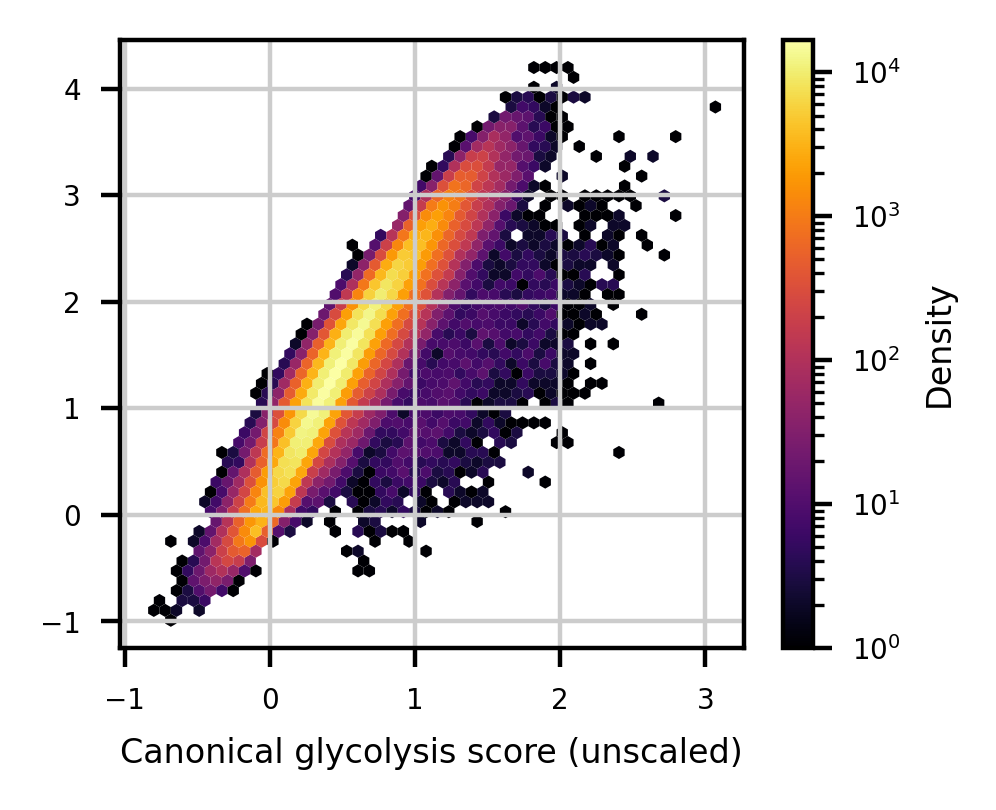

In [391]:
with plt.rc_context({'figure.figsize' : (2.5,2), 'font.size': 5, 'xtick.labelsize' : 5, 'ytick.labelsize' : 5, 'legend.fontsize' : 5, 'axes.labelsize' : 6}):
    plt.hexbin(adata.obs['GO_canonical_glycolysis'], adata.obs['GO_canonical_glycolysis_unscaled'], gridsize=50, cmap='inferno', edgecolors='none', bins='log')
    plt.xlabel('Canonical glycolysis score (scaled)')
    plt.xlabel('Canonical glycolysis score (unscaled)')
    plt.colorbar(label='Density')
    plt.show()

In [393]:
import statsmodels.formula.api as smf
dat = pd.concat([adata.obs['GO_canonical_glycolysis'], adata.obs['GO_canonical_glycolysis_unscaled']], axis=1)
results = smf.ols('GO_canonical_glycolysis ~ GO_canonical_glycolysis_unscaled', data=dat).fit()
print(results.summary())

                               OLS Regression Results                              
Dep. Variable:     GO_canonical_glycolysis   R-squared:                       0.897
Model:                                 OLS   Adj. R-squared:                  0.897
Method:                      Least Squares   F-statistic:                 7.423e+06
Date:                     Tue, 09 Apr 2024   Prob (F-statistic):               0.00
Time:                             09:53:45   Log-Likelihood:             7.3948e+05
No. Observations:                   856616   AIC:                        -1.479e+06
Df Residuals:                       856614   BIC:                        -1.479e+06
Df Model:                                1                                         
Covariance Type:                 nonrobust                                         
                                       coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------

In [ ]:
shared_cN = np.intersect1d(adata.obs_names[np.logical_not(np.isnan(adata.obs['GO_canonical_glycolysis']))],
                           adata.obs_names[adata.obs['annot_level_2']=='Dorsal Telencephalic Neuron'])
dat = adata.obs[['GO_canonical_glycolysis','GO_canonical_glycolysis_unscaled','publication','publication_protocol']].loc[shared_cN,:]
ds = dat['publication_protocol'].value_counts().loc[lambda x: x>20].index
dat = dat.loc[np.isin(dat['publication_protocol'], ds),:]
dat['publication_protocol'] = dat['publication_protocol'].cat.remove_unused_categories()
dat.head()

,GO_canonical_glycolysis,GO_canonical_glycolysis_unscaled,publication,publication_protocol
homosapiens_None_2017_bdrhapsodywholetranscriptomeanalysis_bireyfikri_001_d10_1038_nature22330_1001,0.819711,2.024426,"Birey, 2017","Birey, 2017: Pasca, 2015 (doi: 10.1038/nmeth.3..."
homosapiens_None_2017_bdrhapsodywholetranscriptomeanalysis_bireyfikri_001_d10_1038_nature22330_1002,0.831841,1.897506,"Birey, 2017","Birey, 2017: Pasca, 2015 (doi: 10.1038/nmeth.3..."
homosapiens_None_2017_bdrhapsodywholetranscriptomeanalysis_bireyfikri_001_d10_1038_nature22330_10021,0.748410,1.905767,"Birey, 2017","Birey, 2017: Birey, 2017 (doi: 10.1038/nature2..."
homosapiens_None_2017_bdrhapsodywholetranscriptomeanalysis_bireyfikri_001_d10_1038_nature22330_1005,0.331497,1.091640,"Birey, 2017","Birey, 2017: Pasca, 2015 (doi: 10.1038/nmeth.3..."
homosapiens_None_2017_bdrhapsodywholetranscriptomeanalysis_bireyfikri_001_d10_1038_nature22330_10061,0.601288,1.581090,"Birey, 2017","Birey, 2017: Birey, 2017 (doi: 10.1038/nature2..."


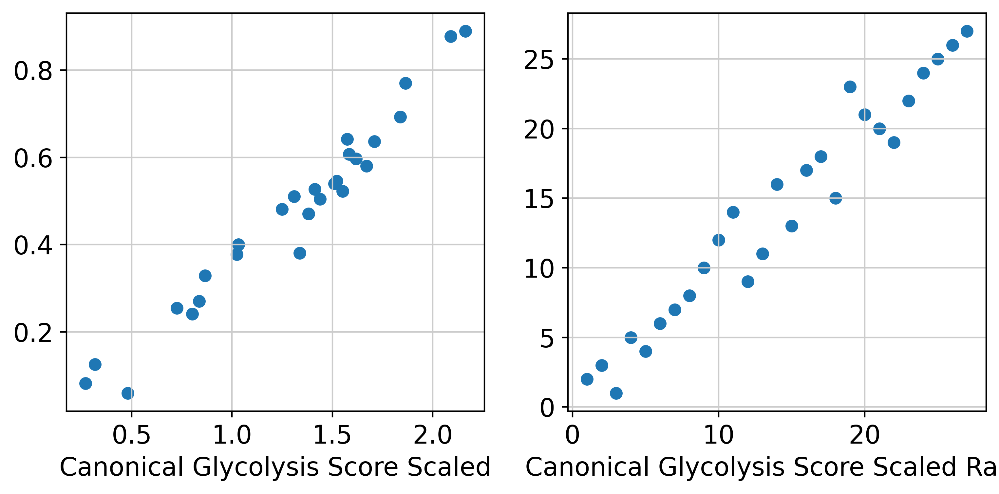

In [443]:
fig, ax = plt.subplots(1,2,figsize=(9,4))
ax[0].scatter(dat[['publication_protocol','GO_canonical_glycolysis_unscaled']].groupby('publication_protocol').mean()['GO_canonical_glycolysis_unscaled'],
              dat[['publication_protocol','GO_canonical_glycolysis']].groupby('publication_protocol').mean()['GO_canonical_glycolysis'])
ax[0].set_xlabel('Canonical Glycolysis Score Unscaled')
ax[0].set_xlabel('Canonical Glycolysis Score Scaled')
ax[1].scatter(util.rankdata(dat[['publication_protocol','GO_canonical_glycolysis_unscaled']].groupby('publication_protocol').mean()['GO_canonical_glycolysis_unscaled']),
              util.rankdata(dat[['publication_protocol','GO_canonical_glycolysis']].groupby('publication_protocol').mean()['GO_canonical_glycolysis']))
ax[1].set_xlabel('Canonical Glycolysis Score Unscaled Rank')
ax[1].set_xlabel('Canonical Glycolysis Score Scaled Rank')
fig.show()

## Save the data

In [444]:
adata.write_h5ad('../../data/phase3_final_0516/ZH_processed_cleanup.h5ad')

## Appendix: reload the processed data

In [378]:
adata = sc.read_h5ad('../../data/phase3_final_0516/ZH_processed_cleanup.h5ad')

# Generate cortical reference for comparison

## Make the merged data

### Braun et al.

In [99]:
adata_braun = sc.read_h5ad('/links/groups/treutlein/USERS/zhisong_he/Work/public_datasets/Linnarsson_fetal_human_brain_atlas/preprint_cellranger/braun_2022_fetal_brain_v2_cleanedup.h5ad')

In [138]:
adata_braun.obs.columns

Index(['CellID', 'SampleID', 'Chemistry', 'Donor', 'Sex', 'Age', 'Region',
       'Subregion', 'Subdivision', 'Tissue', 'SummarizedRegion',
       'TopLevelCluster', 'Cluster', 'CellClass', 'IsNeural',
       'NeurotransmitterTransporter', 'CellType', 'CellCycleFraction',
       'DoubletScore', 'DoubletFlag', 'PresenceScoreOverall_HNOCA',
       'PresenceScoreMax_HNOCA', 'louvain_scvi_res2', 'louvain_scvi_res20'],
      dtype='object')

In [104]:
adata_braun.obs['CellType'][adata_braun.obs['CellClass']=='Neuron'].cat.remove_unused_categories().value_counts()

Ventral telencephalon Neuron NT-GABA     64493
Dorsal telencephalon Neuron NT-VGLUT     60665
Cerebellum Neuron NT-GABA                41647
Ventral telencephalon Neuron NT-VGLUT    19781
Pons Neuron NT-GABA                      15128
Thalamus Neuron NT-VGLUT                 14988
Medulla Neuron NT-GABA                   13179
Thalamus Neuron NT-GABA                  13063
Medulla Neuron NT-GLY                    12260
Pons Neuron NT-VGLUT                     12187
Hypothalamus Neuron NT-GABA              10047
Dorsal telencephalon Neuron NT-GABA       7916
Medulla Neuron NT-VGLUT                   7418
Hypothalamus Neuron NT-VGLUT              7259
Dorsal midbrain Neuron NT-GABA            5860
Cerebellum Neuron NT-VGLUT                5599
Pons Neuron NT-GLY                        4759
Dorsal midbrain Neuron NT-VGLUT           3908
Ventral midbrain Neuron NT-GABA           3739
Cerebellum Neuron NT-GLY                  2427
Ventral midbrain Neuron NT-VGLUT          2058
Ventral telen

In [106]:
adata_braun_cN = adata_braun[adata_braun.obs['CellType']=='Dorsal telencephalon Neuron NT-VGLUT',:]
adata_braun_cN.shape

(60665, 33538)

In [204]:
adata_braun_cN.obs['dataset'] = 'Braun, 2023'
adata_braun_cN.obs['sample'] = adata_braun_cN.obs['SampleID'].copy()
adata_braun_cN.obs['individual'] = adata_braun_cN.obs['Donor'].copy()
adata_braun_cN.obs['stage'] = 'First_trimester'
adata_braun_cN.obs['age'] = adata_braun_cN.obs['Age'].copy()
adata_braun_cN.obs['label'] = adata_braun_cN.obs['Cluster'].copy()

### Eze et al.

In [111]:
adata_eze = sc.read_h5ad(
    '/links/groups/treutlein/USERS/zhisong_he/Work/public_datasets/Eze_NatNeuro_2021_early_human_brain_scRNAseq/reanalysis/merged_meta_added_unique.h5ad'
)

In [112]:
adata_eze.obs.columns

Index(['orig.ident.x', 'nCount_RNA', 'nFeature_RNA', 'sample', 'timepoint',
       'region', 'percent.mt', 'percent.rp', 'S.Score', 'G2M.Score', 'Phase',
       'individual', 'region2', 'barcode', 'cell_name', 'orig_id', 'nGene',
       'nUMI', 'orig.ident.y', 'Individual', 'Cluster', 'Area', 'percent.ribo',
       'Area_asannotatedduringdissection', 'Individual.Clustering', 'Age',
       'Barcode'],
      dtype='object')

In [114]:
adata_eze.obs['Cluster'] = adata_eze.obs['Cluster'].astype('category')

In [116]:
adata_eze = adata_eze[adata_eze.obs['nFeature_RNA'] > 300,:]
sc.pp.highly_variable_genes(adata_eze, flavor='seurat_v3', n_top_genes=3000)
adata_eze.raw = adata_eze
adata_eze = adata_eze[:,adata_eze.var['highly_variable']]
sc.pp.scale(adata_eze)
sc.pp.pca(adata_eze)

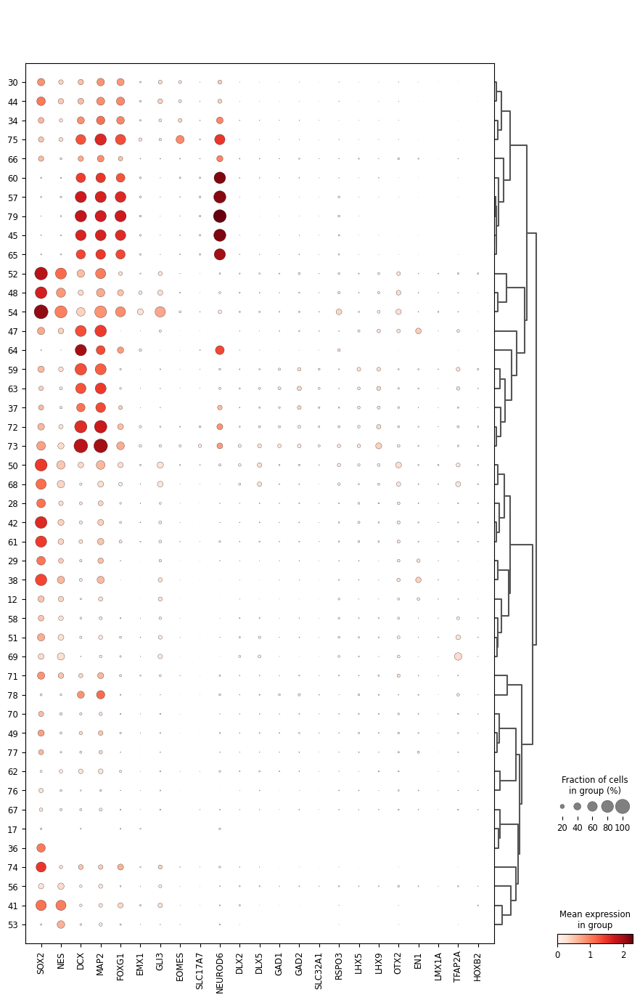

In [117]:
sc.pl.dotplot(adata_eze, ['SOX2','NES','DCX','MAP2',
                          'FOXG1','EMX1','GLI3','EOMES','SLC17A7','NEUROD6',
                          'DLX2','DLX5','GAD1','GAD2','SLC32A1',
                          'RSPO3','LHX5','LHX9','OTX2','EN1','LMX1A','TFAP2A','HOXB2'], groupby='Cluster', dendrogram=True)

In [119]:
adata_eze_raw = sc.read_h5ad(
    '/links/groups/treutlein/USERS/zhisong_he/Work/public_datasets/Eze_NatNeuro_2021_early_human_brain_scRNAseq/reanalysis/merged_meta_added_unique.h5ad'
)
adata_eze_cN = adata_eze_raw[np.isin(adata_eze_raw.obs['Cluster'],[60,57,79,45,65]),:]
adata_eze_cN.shape

(21255, 33694)

In [205]:
adata_eze_cN.obs['dataset'] = 'Eze, 2021'
adata_eze_cN.obs['stage'] = 'First_trimester'
adata_eze_cN.obs['age'] = adata_eze_cN.obs['timepoint'].copy()
adata_eze_cN.obs['label'] = adata_eze_cN.obs['Cluster'].copy()

### Bhaduri et al.

In [120]:
adata_bhaduri = sc.read_h5ad(
    '/links/groups/treutlein/USERS/zhisong_he/Work/public_datasets/Bhaduri_Nature_2021_human_dev_brain_2nd_trimester/data/Bhaduri_2021_merged_withmeta.h5ad'
)

In [121]:
adata_bhaduri.obs.columns

Index(['sample', 'stage', 'individual', 'area_dissection', 'area',
       'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts',
       'log1p_total_counts', 'pct_counts_in_top_50_genes',
       'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes',
       'pct_counts_in_top_500_genes', 'total_counts_mito',
       'log1p_total_counts_mito', 'pct_counts_mito', 'barcode', 'cell_id',
       'sample_revised', 'cell_id_revised', 'clusterv1', 'clusterv2 - final',
       'clusterv2_id', 'lamina', 'cell type'],
      dtype='object')

In [129]:
adata_bhaduri_N = adata_bhaduri[adata_bhaduri.obs['cell type']=='Neuron',:].copy()
adata_bhaduri_N.shape

(261035, 33694)

In [131]:
adata_bhaduri_N.layers['counts'] = adata_bhaduri_N.X.copy()
sc.pp.normalize_total(adata_bhaduri_N)
sc.pp.log1p(adata_bhaduri_N)
sc.pp.highly_variable_genes(adata_bhaduri_N, flavor='seurat_v3', n_top_genes=3000)
adata_bhaduri_N.raw = adata_bhaduri_N
adata_bhaduri_N = adata_bhaduri_N[:,adata_bhaduri_N.var['highly_variable']]
sc.pp.scale(adata_bhaduri_N)
sc.pp.pca(adata_bhaduri_N)

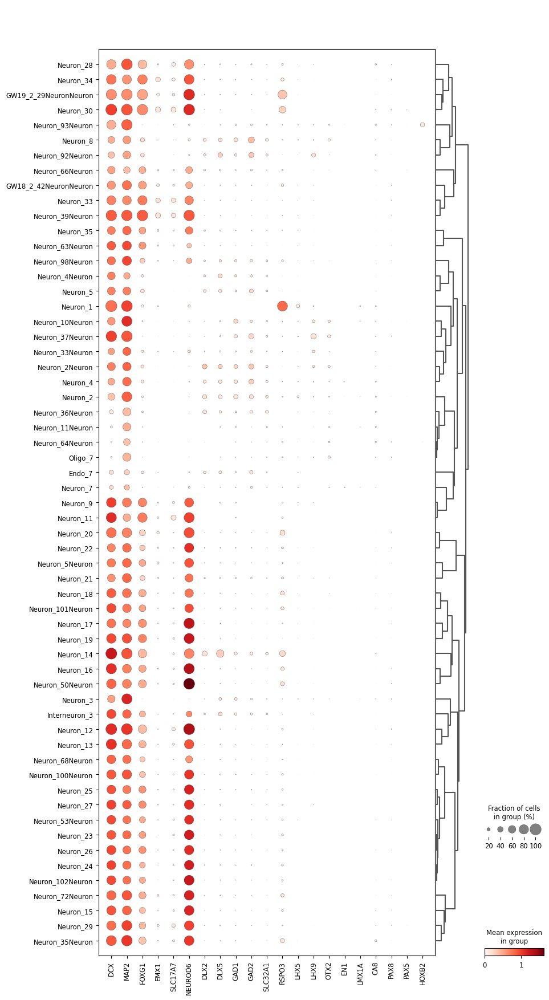

In [133]:
adata_bhaduri_N.obs['clusterv2 - final'] = adata_bhaduri_N.obs['clusterv2 - final'].cat.remove_unused_categories()
sc.pl.dotplot(adata_bhaduri_N, ['DCX','MAP2','FOXG1','EMX1','SLC17A7','NEUROD6',
                                'DLX2','DLX5','GAD1','GAD2','SLC32A1',
                                'RSPO3','LHX5','LHX9','OTX2','EN1','LMX1A','CA8','PAX8','PAX5','HOXB2'], groupby='clusterv2 - final', dendrogram=True)

In [134]:
cl_cN = [
    'Neuron_28', 'Neuron_34', 'GW19_2_29NeuronNeuron', 'Neuron_30', 'Neuron_66Neuron', 'GW18_2_42NeuronNeuron', 'Neuron_33', 'Neuron_39Neuron', 'Neuron_35', 'Neuron_63Neuron', 'Neuron_9', 'Neuron_11', 'Neuron_20', 'Neuron_22', 'Neuron_5Neuron', 'Neuron_21', 'Neuron_18', 'Neuron_101Neuron', 'Neuron_17', 'Neuron_19', 'Neuron_16', 'Neuron_50Neuron', 'Neuron_12', 'Neuron_13', 'Neuron_68Neuron', 'Neuron_100Neuron', 'Neuron_25', 'Neuron_27', 'Neuron_53Neuron', 'Neuron_23', 'Neuron_26', 'Neuron_24', 'Neuron_102Neuron', 'Neuron_72Neuron', 'Neuron_15', 'Neuron_29', 'Neuron_35Neuron'
]
adata_bhaduri_cN = adata_bhaduri[((adata_bhaduri.obs['cell type']=='Neuron') & np.isin(adata_bhaduri.obs['clusterv2 - final'], cl_cN)),:].copy()
adata_bhaduri_cN.shape

(210238, 33694)

In [206]:
adata_bhaduri_cN.obs['label'] = adata_bhaduri_cN.obs['clusterv2 - final'].copy()
adata_bhaduri_cN.obs['stage'] = 'Second_trimester'
adata_bhaduri_cN.obs['age'] = adata_bhaduri_cN.obs['stage'].copy()
adata_bhaduri_cN.obs['dataset'] = 'Bhaduri, 2021'

In [185]:
adata_bhaduri_cN.layers['counts'] = adata_bhaduri_cN.X.copy()
sc.pp.normalize_total(adata_bhaduri_cN)
sc.pp.log1p(adata_bhaduri_cN)

### Wang et al.

In [172]:
adata_wang = sc.read_h5ad(
    '/links/groups/treutlein/USERS/zhisong_he/Work/public_datasets/Wang_Kriegstein_bioRxiv_2024_neocortex_development_scmultiome/GEX.h5ad'
)

In [173]:
adata_wang_N = sc.read_h5ad(
    '/links/groups/treutlein/USERS/zhisong_he/Work/public_datasets/Wang_Kriegstein_bioRxiv_2024_neocortex_development_scmultiome/GEX_neuronal.h5ad'
)

In [174]:
adata_wang_N.obs.columns

Index(['dataset', 'Group', 'sex', 'Region', 'class', 'subclass', 'type',
       'Estimated_postconceptional_age_in_days', 'nCount_RNA', 'nFeature_RNA',
       'nucleosome_signal', 'TSS.enrichment', 'SCR_score'],
      dtype='object')

In [207]:
cN_types_wang = [ x for x in adata_wang_N.obs['type'].unique() if x.startswith('EN-') ]
adata_wang_cN = adata_wang_N[np.isin(adata_wang_N.obs['type'], cN_types_wang),:]
adata_wang_cN.shape

(109285, 32480)

In [208]:
adata_wang_cN.obs['sample'] = adata_wang_cN.obs['dataset'].copy()
adata_wang_cN.obs['dataset'] = 'Wang, 2024'
adata_wang_cN.obs['stage'] = adata_wang_cN.obs['Group'].copy()
adata_wang_cN.obs['age'] = adata_wang_cN.obs['Estimated_postconceptional_age_in_days'].copy()
adata_wang_cN.obs['label'] = adata_wang_cN.obs['type'].copy()

ind_sample = dict(zip(
    ['HDBR-15020-FB', 'HDBR-14834-TC', 'HDBR-14584-CTX', 'HDBR-14831-CTX', 'ARKFrozen-45-CTX', 'ARKFrozen-20-CTX', 'ARKFrozen-37-CTX', 'ARKFrozen-18-PFC', 'ARKFrozen-19-V1', 'ARKFrozen-41-PFC-2', 'ARKFrozen-41-V1', 'ARKFrozen-1-PFC', 'ARKFrozen-32-V1', 'ARKFrozen-43-PFC', 'ARKFrozen-8-V1', 'GW27-2-7-18-PFC', 'NIH-5900-BA17', 'NIH-4267-BA10-2', 'NIH-M1154-BA10-2', 'NIH-M2837-BA10-2', 'NIH-4373-BA9-3', 'NIH-4373-BA17', 'NIH-1325-BA10-2', 'NIH-1325-BA17', 'NIH-4458-BA9-3', 'NIH-4458-BA17', 'NIH-4392-BA9', 'NIH-4392-BA17', 'NIH-1671-BA10-2', 'NIH-1671-BA17', 'NIH-5554-BA9', 'NIH-5554-BA17', 'NIH-5162-BA9', 'NIH-5162-BA17', 'NIH-5376-BA9', 'NIH-5376-BA17', 'NIH-4341-BA9', 'NIH-4341-BA17'],
    ['HDBR-15020', 'HDBR-14834', 'HDBR-14584', 'HDBR-14831', 'ARK35', 'ARK15', 'ARK28', 'ARK14', 'ARK14', 'ARK31', 'ARK31', 'ARK1', 'ARK25', 'ARK33', 'ARK5', 'GW27-2-7-18', 'NIH-5900', 'NIH-4267', 'NIH-M1154', 'NIH-M2837', 'NIH-4373', 'NIH-4373', 'NIH-1325', 'NIH-1325', 'NIH-4458', 'NIH-4458', 'NIH-4392', 'NIH-4392', 'NIH-1671', 'NIH-1671', 'NIH-5554', 'NIH-5554', 'NIH-5162', 'NIH-5162', 'NIH-5376', 'NIH-5376', 'NIH-4341', 'NIH-4341']
))
adata_wang_cN.obs['individual'] = [ ind_sample[x] for x in adata_wang_cN.obs['sample'] ]

In [209]:
adata_wang_cN.obs.head()

,dataset,Group,sex,Region,class,subclass,type,Estimated_postconceptional_age_in_days,nCount_RNA,nFeature_RNA,nucleosome_signal,TSS.enrichment,SCR_score,sample,stage,age,label,individual
ARKFrozen-18-PFC_AAACAGCCAAGGTGCA-1,"Wang, 2024",Second_trimester,M,PFC,Neuron,Glutamatergic neuron,EN-IT-Immature,98.0,5071.0,2436,0.675652,4.279853,0.078697,ARKFrozen-18-PFC,Second_trimester,98.0,EN-IT-Immature,ARK14
ARKFrozen-18-PFC_AAACAGCCAATTGAAG-1,"Wang, 2024",Second_trimester,M,PFC,Neuron,Glutamatergic neuron,EN-Newborn,98.0,1106.0,786,0.540816,11.074640,0.018244,ARKFrozen-18-PFC,Second_trimester,98.0,EN-Newborn,ARK14
ARKFrozen-18-PFC_AAACAGCCACTAAATC-1,"Wang, 2024",Second_trimester,M,PFC,Neuron,Glutamatergic neuron,EN-L5-ET,98.0,5564.0,2508,0.722840,4.330033,0.118406,ARKFrozen-18-PFC,Second_trimester,98.0,EN-L5-ET,ARK14
ARKFrozen-18-PFC_AAACAGCCATGAATAG-1,"Wang, 2024",Second_trimester,M,PFC,Neuron,Glutamatergic neuron,EN-Non-IT-Immature,98.0,4478.0,2155,0.691218,4.729169,0.103814,ARKFrozen-18-PFC,Second_trimester,98.0,EN-Non-IT-Immature,ARK14
ARKFrozen-18-PFC_AAACATGCAATAATCC-1,"Wang, 2024",Second_trimester,M,PFC,Neuron,Glutamatergic neuron,EN-L6b,98.0,3829.0,1980,0.784257,4.904187,0.013748,ARKFrozen-18-PFC,Second_trimester,98.0,EN-L6b,ARK14


In [247]:
adata_wang_cN.layers['counts'] = adata_wang_cN.X.expm1()

### Merge all

In [251]:
adata_braun_cN.var_names_make_unique()
adata_eze_cN.var_names_make_unique()
adata_bhaduri_cN.var_names_make_unique()
adata_wang_cN.var_names_make_unique()

In [252]:
adata_ref = anndata.concat([
    adata_braun_cN,
    adata_eze_cN,
    adata_bhaduri_cN,
    adata_wang_cN
], join='inner')

In [253]:
adata_ref.shape

(401443, 19808)

In [254]:
adata_ref.layers.keys()

KeysView(Layers with keys: counts)

In [255]:
adata_ref.obs.columns

Index(['sample', 'individual', 'label', 'dataset', 'age', 'stage'], dtype='object')

In [256]:
adata_ref.obs[['dataset','individual','sample','stage','age','label']].tail()

,dataset,individual,sample,stage,age,label
NIH-M2837-BA10-2_TTTGTGTTCAATCATG-1,"Wang, 2024",NIH-M2837,NIH-M2837-BA10-2,Third_trimester,246.0,EN-L2_3-IT
NIH-M2837-BA10-2_TTTGTGTTCATGAAGG-1,"Wang, 2024",NIH-M2837,NIH-M2837-BA10-2,Third_trimester,246.0,EN-L4-IT
NIH-M2837-BA10-2_TTTGTGTTCATTACAG-1,"Wang, 2024",NIH-M2837,NIH-M2837-BA10-2,Third_trimester,246.0,EN-L4-IT
NIH-M2837-BA10-2_TTTGTGTTCCCATAAA-1,"Wang, 2024",NIH-M2837,NIH-M2837-BA10-2,Third_trimester,246.0,EN-L2_3-IT
NIH-M2837-BA10-2_TTTGTTGGTTTAGTCC-1,"Wang, 2024",NIH-M2837,NIH-M2837-BA10-2,Third_trimester,246.0,EN-L4-IT


In [257]:
adata_ref.obs = adata_ref.obs[['dataset','individual','sample','stage','age','label']].copy()
adata_ref.obs['age'] = adata_ref.obs['age'].astype('str')
adata_ref.obs['label'] = adata_ref.obs['label'].astype('str')

In [258]:
adata_ref.write_h5ad('../../ext/ref_cortical-neuron_Braun-Eze-Bhaduri-Wang.h5ad')

## Transfer cell type labels from Wang et al. and then do scPoli

### Transfer labels with max-cluster-correlation

In [282]:
adata_wang_avg_cl_stages = sc.read_h5ad(
    '/links/groups/treutlein/USERS/zhisong_he/Work/public_datasets/Wang_Kriegstein_bioRxiv_2024_neocortex_development_scmultiome/analysis/GEX_scpoli_cluster_average.h5ad'
)

In [291]:
ct_EN = [ x for x in adata_wang_avg_cl_stages.obs['type'].unique() if x.startswith('EN-') ]
adata_wang_avg_cl_stages_EN = adata_wang_avg_cl_stages[np.isin(adata_wang_avg_cl_stages.obs['type'], ct_EN),:]

In [292]:
shared_genes = np.intersect1d(adata_wang_avg_cl_stages_EN.var_names, adata_ref.raw.var_names)
len(shared_genes)

2371

In [293]:
ranked_wang_avg_cl_stages_EN = util.rankMatrix_nonzero(adata_wang_avg_cl_stages_EN[:,shared_genes].X.T)
ranked_X = util.rankMatrix_nonzero(adata_ref.raw[:,shared_genes].X.T)

In [294]:
cor2avg_spearman = util.corSparse(ranked_X, ranked_wang_avg_cl_stages_EN)

In [297]:
maxcorr_meta = adata_wang_avg_cl_stages_EN.obs[['Stage','class','subclass','type']].iloc[np.argmax(cor2avg_spearman, axis=1),:].set_axis(adata_ref.obs_names, axis=0)
maxcorr_meta.head()

,Stage,class,subclass,type
10X89_1:AAAGATGTCTGGTTCC,First_trimester,Neuron,Glutamatergic neuron,EN-Newborn
10X89_1:AACTCCCAGACGACGT,First_trimester,Neuron,Glutamatergic neuron,EN-Newborn
10X89_1:AAGACCTCAGGTGCCT,First_trimester,Neuron,Glutamatergic neuron,EN-Non-IT-Immature
10X89_1:AATCCAGGTTGGTGGA,First_trimester,Neuron,Glutamatergic neuron,EN-Newborn
10X89_1:ACGGAGACAATAGCGG,First_trimester,Neuron,Glutamatergic neuron,EN-Non-IT-Immature


In [298]:
maxcorr_meta['type'].value_counts()

EN-Newborn            185148
EN-IT-Immature         58337
EN-Non-IT-Immature     51706
EN-L6b                 36108
EN-L5-IT               18952
EN-L4-IT               17560
EN-L2_3-IT             15273
EN-L6-IT               11073
EN-L5_6-NP              3856
EN-L6-CT                2896
EN-L5-ET                 534
Name: type, dtype: int64

In [303]:
ct_ordered = ['EN-Newborn','EN-IT-Immature','EN-L2_3-IT','EN-L4-IT','EN-L5-IT','EN-L6-IT','EN-Non-IT-Immature','EN-L5-ET','EN-L5_6-NP','EN-L6-CT','EN-L6b']
pd.crosstab(adata_ref.obs['label'][adata_ref.obs['dataset']=='Wang, 2024'],
            maxcorr_meta['type'][adata_ref.obs['dataset']=='Wang, 2024']).loc[ct_ordered,ct_ordered]

type,EN-Newborn,EN-IT-Immature,EN-L2_3-IT,EN-L4-IT,EN-L5-IT,EN-L6-IT,EN-Non-IT-Immature,EN-L5-ET,EN-L5_6-NP,EN-L6-CT,EN-L6b
label,,,,,,,,,,,
EN-Newborn,17827,1283,139,60,365,2,1174,2,0,0,40
EN-IT-Immature,884,10033,1153,411,483,736,419,6,1,0,274
EN-L2_3-IT,60,310,10645,758,27,12,113,1,0,0,2
EN-L4-IT,96,725,2933,15422,691,70,322,9,1,1,18
EN-L5-IT,14,170,46,433,8711,186,69,7,0,0,2
EN-L6-IT,164,509,51,32,407,6513,176,8,0,0,8
EN-Non-IT-Immature,504,526,64,18,22,177,6843,30,96,262,1326
EN-L5-ET,164,50,3,6,18,2,482,258,55,0,111
EN-L5_6-NP,23,6,3,2,2,1,216,25,1328,2,170


In [305]:
pd.crosstab(adata_ref.obs['dataset'], maxcorr_meta['Stage'])

Stage,First_trimester,Second_trimester,Third_trimester,Infancy,Adolescence
dataset,,,,,
"Bhaduri, 2021",14267,176442,18607,907,15
"Braun, 2023",48311,12348,5,1,0
"Eze, 2021",5913,14642,684,16,0
"Wang, 2024",7651,41523,16002,27119,16990


In [306]:
stage_ordered = ['First_trimester','Second_trimester','Third_trimester','Infancy','Adolescence']
pd.crosstab(adata_ref.obs['stage'][adata_ref.obs['dataset']=='Wang, 2024'],
            maxcorr_meta['Stage'][adata_ref.obs['dataset']=='Wang, 2024']).loc[stage_ordered,stage_ordered]

Stage,First_trimester,Second_trimester,Third_trimester,Infancy,Adolescence
stage,,,,,
First_trimester,7553,51,2,0,0
Second_trimester,98,41395,2852,19,0
Third_trimester,0,76,12834,86,2
Infancy,0,1,310,26888,83
Adolescence,0,0,4,126,16905


In [307]:
adata_ref.obs['pred_stage'] = list(maxcorr_meta['Stage'])
adata_ref.obs['pred_class'] = list(maxcorr_meta['class'])
adata_ref.obs['pred_subclass'] = list(maxcorr_meta['subclass'])
adata_ref.obs['pred_type'] = list(maxcorr_meta['type'])

In [308]:
adata_ref.obs.head()

,dataset,individual,sample,stage,age,label,_scvi_batch,_scvi_labels,pred_stage,pred_class,pred_subclass,pred_type
10X89_1:AAAGATGTCTGGTTCC,"Braun, 2023",BRC2006,10X89_1,First_trimester,8.0,294,9,0,First_trimester,Neuron,Glutamatergic neuron,EN-Newborn
10X89_1:AACTCCCAGACGACGT,"Braun, 2023",BRC2006,10X89_1,First_trimester,8.0,294,9,0,First_trimester,Neuron,Glutamatergic neuron,EN-Newborn
10X89_1:AAGACCTCAGGTGCCT,"Braun, 2023",BRC2006,10X89_1,First_trimester,8.0,294,9,0,First_trimester,Neuron,Glutamatergic neuron,EN-Non-IT-Immature
10X89_1:AATCCAGGTTGGTGGA,"Braun, 2023",BRC2006,10X89_1,First_trimester,8.0,294,9,0,First_trimester,Neuron,Glutamatergic neuron,EN-Newborn
10X89_1:ACGGAGACAATAGCGG,"Braun, 2023",BRC2006,10X89_1,First_trimester,8.0,294,9,0,First_trimester,Neuron,Glutamatergic neuron,EN-Non-IT-Immature


In [334]:
adata_ref.obs['pred_cl_idx'] = np.argmax(cor2avg_spearman, axis=1)
adata_ref.obs.head()

,dataset,individual,sample,stage,age,label,_scvi_batch,_scvi_labels,pred_stage,pred_class,pred_subclass,pred_type,conditions_combined,pred_cl_idx
10X89_1:AAAGATGTCTGGTTCC,"Braun, 2023",BRC2006,10X89_1,First_trimester,8.0,294,9,0,First_trimester,Neuron,Glutamatergic neuron,EN-Newborn,BRC2006,7
10X89_1:AACTCCCAGACGACGT,"Braun, 2023",BRC2006,10X89_1,First_trimester,8.0,294,9,0,First_trimester,Neuron,Glutamatergic neuron,EN-Newborn,BRC2006,7
10X89_1:AAGACCTCAGGTGCCT,"Braun, 2023",BRC2006,10X89_1,First_trimester,8.0,294,9,0,First_trimester,Neuron,Glutamatergic neuron,EN-Non-IT-Immature,BRC2006,12
10X89_1:AATCCAGGTTGGTGGA,"Braun, 2023",BRC2006,10X89_1,First_trimester,8.0,294,9,0,First_trimester,Neuron,Glutamatergic neuron,EN-Newborn,BRC2006,7
10X89_1:ACGGAGACAATAGCGG,"Braun, 2023",BRC2006,10X89_1,First_trimester,8.0,294,9,0,First_trimester,Neuron,Glutamatergic neuron,EN-Non-IT-Immature,BRC2006,4


In [335]:
adata_ref.write_h5ad('../../ext/ref_cortical-neuron_Braun-Eze-Bhaduri-Wang_scpoli.h5ad')

### Run scPoli

In [103]:
adata_ref = sc.read_h5ad('../../ext/ref_cortical-neuron_Braun-Eze-Bhaduri-Wang_scpoli.h5ad')

In [310]:
import scarches

 captum (see https://github.com/pytorch/captum).


In [313]:
from scipy import sparse
adata_ref.layers['lognorm'] = adata_ref.X.copy()
adata_ref.X = sparse.csr_matrix(adata_ref.layers['counts'])

In [357]:
pd.crosstab(adata_ref.obs['dataset'], adata_ref.obs['pred_type'])

pred_type,EN-IT-Immature,EN-L2_3-IT,EN-L4-IT,EN-L5-ET,EN-L5-IT,EN-L5_6-NP,EN-L6-CT,EN-L6-IT,EN-L6b,EN-Newborn,EN-Non-IT-Immature
dataset,,,,,,,,,,,
"Bhaduri, 2021",42497,225,385,74,7870,2117,1065,3266,11964,123705,17070
"Braun, 2023",74,1,0,5,0,1,0,4,13938,26806,19836
"Eze, 2021",2138,3,14,2,349,166,19,71,800,14879,2814
"Wang, 2024",13628,15044,17161,453,10733,1572,1812,7732,9406,19758,11986


In [359]:
adata_ref.obs['pred_cl_idx'] = adata_ref.obs['pred_cl_idx'].astype('category')

In [368]:
scpoli_model = scarches.models.scpoli.scPoli(
    adata=adata_ref,
    condition_keys='sample',
    cell_type_keys=['pred_type','pred_cl_idx'],
    unknown_ct_names=['unknown'],
    hidden_layer_sizes=[512],
    latent_dim=20,
    embedding_dims=10,
    recon_loss='nb',
)
early_stopping_kwargs = {
    "early_stopping_metric": "val_prototype_loss",
    "mode": "min",
    "threshold": 0,
    "patience": 20,
    "reduce_lr": True,
    "lr_patience": 13,
    "lr_factor": 0.1,
}

Embedding dictionary:
 	Num conditions: [254]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 3000 512 10
	Mean/Var Layer in/out: 512 20
Decoder Architecture:
	First Layer in, out and cond:  20 512 10
	Output Layer in/out:  512 3000 



In [369]:
scpoli_model.train(
    n_epochs=35,
    pretraining_epochs=20,
    early_stopping_kwargs=early_stopping_kwargs,
    eta=10,
    alpha_epoch_anneal=20,
    batch_size=32768,
)

Initializing dataloaders
Starting training
 |███████████---------| 57.1%  - val_loss: 1266.55 - val_cvae_loss: 1266.55
Initializing unlabeled prototypes with Leiden with an unknown number of  clusters.
Clustering succesful. Found 32 clusters.
 |████████████████████| 100.0%  - val_loss: 1627.26 - val_cvae_loss: 1321.93 - val_prototype_loss:  305.34 - val_unlabeled_loss:    2.37 - val_labeled_loss:   30.53


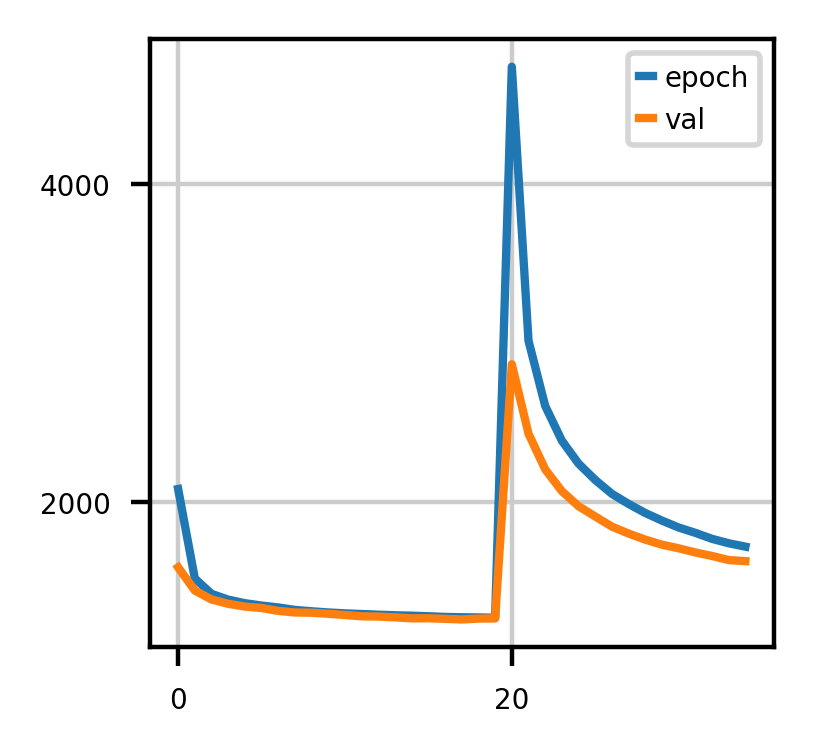

In [370]:
import matplotlib.pyplot as plt
with plt.rc_context({'figure.figsize' : (2,2), 'font.size': 5, 'xtick.labelsize' : 5, 'ytick.labelsize' : 5, 'legend.fontsize' : 5}):
    plt.plot(scpoli_model.trainer.logs['epoch_loss'], label='epoch')
    plt.plot(scpoli_model.trainer.logs['val_loss'], label='val')
    plt.legend()

In [371]:
scpoli_model.save("../../ext/models_cN_joint/scpoli", overwrite=True)
scpoli_model.get_conditional_embeddings().write_h5ad("../../ext/models_cN_joint/scpoli/sample_embedding.h5ad")

In [372]:
adata_ref.obsm["X_scpoli"] = scpoli_model.get_latent(
    adata_ref,
    mean=True
)
sc.pp.neighbors(adata_ref, use_rep='X_scpoli')
sc.tl.umap(adata_ref)
adata_ref.obsm['X_umap_scpoli'] = adata_ref.obsm['X_umap'].copy()

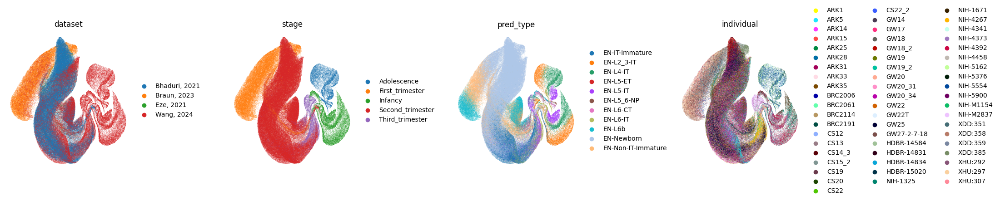

In [104]:
from matplotlib.pyplot import rc_context
with rc_context({'figure.figsize': (3.5,4)}):
    sc.pl.embedding(adata_ref, basis='X_umap_scpoli',
                    color=['dataset','stage','pred_type','individual'],
                    frameon=False, add_outline=False, wspace=0.6, na_color='lightgray', size=0.5, ncols=4)

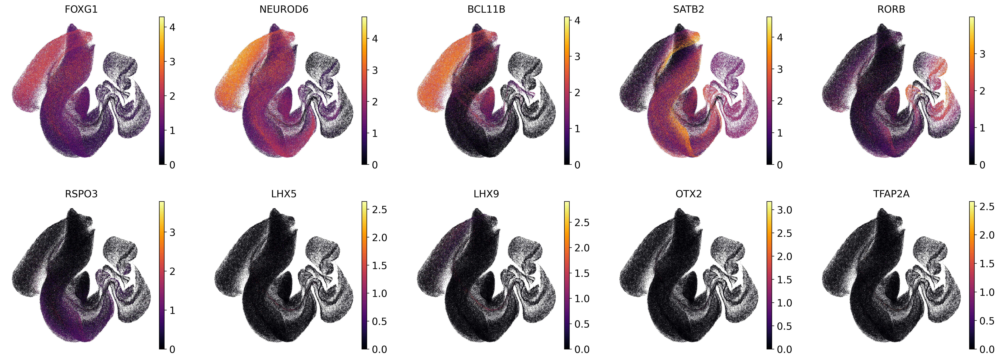

In [374]:
from matplotlib.pyplot import rc_context
with rc_context({'figure.figsize': (4,4)}):
    sc.pl.embedding(adata_ref, basis='X_umap_scpoli',
                    color=['FOXG1','NEUROD6','BCL11B','SATB2','RORB','RSPO3','LHX5','LHX9','OTX2','TFAP2A'],
                    frameon=False, add_outline=False, color_map='inferno', size=0.5, ncols=5)

In [375]:
adata_ref.write_h5ad('../../ext/ref_cortical-neuron_Braun-Eze-Bhaduri-Wang_scpoli.h5ad')

### Clustering based on scPoli

In [376]:
sc.tl.louvain(adata_ref, key_added='louvain_scpoli_res10', resolution=10)

In [377]:
sc.tl.louvain(adata_ref, key_added='louvain_scpoli_res1', resolution=1)

In [400]:
adata_ref.write_h5ad('../../ext/ref_cortical-neuron_Braun-Eze-Bhaduri-Wang_scpoli.h5ad')

In [394]:
len(adata_ref.obs['louvain_scpoli_res10'].unique())

175

In [397]:
avg_cl = util.summarize_numeric_matrix(adata_ref.raw.X, adata_ref.obs['louvain_scpoli_res10'])
meta_cl = util.summarize_dataframe(adata_ref.obs, adata_ref.obs['louvain_scpoli_res10'])
adata_ref_cl = anndata.AnnData(X=avg_cl, obs=meta_cl, var=adata_ref.raw.var.copy())
sc.pp.highly_variable_genes(adata_ref_cl, flavor='cell_ranger', n_top_genes = 3000)

In [402]:
adata_ref_cl.write_h5ad(
    '../../ext/ref_cortical-neuron_Braun-Eze-Bhaduri-Wang_scpoli_cluster-average.h5ad'
)

## Metabolic states of primary data

In [414]:
adata_ref = sc.read_h5ad('../../ext/ref_cortical-neuron_Braun-Eze-Bhaduri-Wang.h5ad')

In [ ]:
genes_glycolysis_GO = [
    "TPI1", "PGAM1", "PKLR", "PGAM2", "ENO1", "FOXK2", "ENO2", "FOXK1", "ENO3", "HK1", "HK3", "GCK", "HK2", "PKM", "PFKM", "PFKL", "GAPDHS", "PGK1", "ALDOC", "ALDOB", "ALDOA", "GAPDH", "GPI", "PFKP"
]
sc.tl.score_genes(adata_ref, genes_glycolysis_GO, score_name='GO_canonical_glycolysis_joint')

In [422]:
adata_ref_ds = [ adata_ref[adata_ref.obs['dataset']==x,:] for x in adata_ref.obs['dataset'].cat.categories ]

In [423]:
for x in tqdm(adata_ref_ds):
    sc.tl.score_genes(x, genes_glycolysis_GO, score_name='GO_canonical_glycolysis_ds')

100%|██████████| 4/4 [00:46<00:00, 11.68s/it]


In [427]:
adata_ref.obs['GO_canonical_glycolysis_ds'] = pd.concat([x.obs['GO_canonical_glycolysis_ds'] for x in adata_ref_ds])[adata_ref.obs_names]

In [429]:
from scipy.stats import pearsonr, spearmanr
[ pearsonr(adata_ref.obs['GO_canonical_glycolysis_ds'], adata_ref.obs['GO_canonical_glycolysis_joint']),
  spearmanr(adata_ref.obs['GO_canonical_glycolysis_ds'], adata_ref.obs['GO_canonical_glycolysis_joint']) ]

[PearsonRResult(statistic=0.9792547853382519, pvalue=0.0),
 SignificanceResult(statistic=0.9797685296342475, pvalue=0.0)]

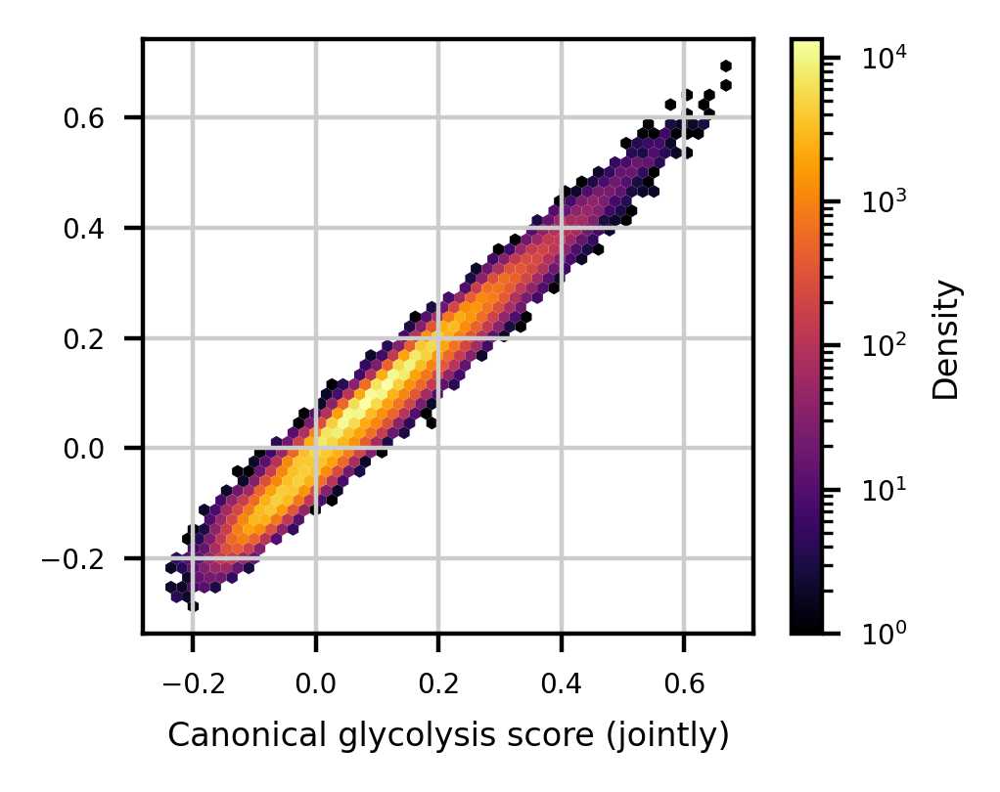

In [430]:
with plt.rc_context({'figure.figsize' : (2.5,2), 'font.size': 5, 'xtick.labelsize' : 5, 'ytick.labelsize' : 5, 'legend.fontsize' : 5, 'axes.labelsize' : 6}):
    plt.hexbin(adata_ref.obs['GO_canonical_glycolysis_ds'], adata_ref.obs['GO_canonical_glycolysis_joint'], gridsize=50, cmap='inferno', edgecolors='none', bins='log')
    plt.xlabel('Canonical glycolysis score (per dataset)')
    plt.xlabel('Canonical glycolysis score (jointly)')
    plt.colorbar(label='Density')
    plt.show()

In [433]:
import statsmodels.formula.api as smf
dat = pd.concat([adata_ref.obs['GO_canonical_glycolysis_ds'], adata_ref.obs['GO_canonical_glycolysis_joint']], axis=1)
results = smf.ols('GO_canonical_glycolysis_ds ~ GO_canonical_glycolysis_joint', data=dat).fit()
print(results.summary())

                                OLS Regression Results                                
Dep. Variable:     GO_canonical_glycolysis_ds   R-squared:                       0.959
Model:                                    OLS   Adj. R-squared:                  0.959
Method:                         Least Squares   F-statistic:                 9.375e+06
Date:                        Tue, 09 Apr 2024   Prob (F-statistic):               0.00
Time:                                14:02:08   Log-Likelihood:             1.0050e+06
No. Observations:                      401443   AIC:                        -2.010e+06
Df Residuals:                          401441   BIC:                        -2.010e+06
Df Model:                                   1                                         
Covariance Type:                    nonrobust                                         
                                    coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------

In [434]:
sc.tl.score_genes(adata_ref, genes_glycolysis_GO, score_name='GO_canonical_glycolysis_joint2', random_state=100)

In [435]:
from scipy.stats import pearsonr, spearmanr
[ pearsonr(adata_ref.obs['GO_canonical_glycolysis_joint2'], adata_ref.obs['GO_canonical_glycolysis_joint']),
  spearmanr(adata_ref.obs['GO_canonical_glycolysis_joint2'], adata_ref.obs['GO_canonical_glycolysis_joint']) ]

[PearsonRResult(statistic=0.9894737208736966, pvalue=0.0),
 SignificanceResult(statistic=0.9892676340324541, pvalue=0.0)]

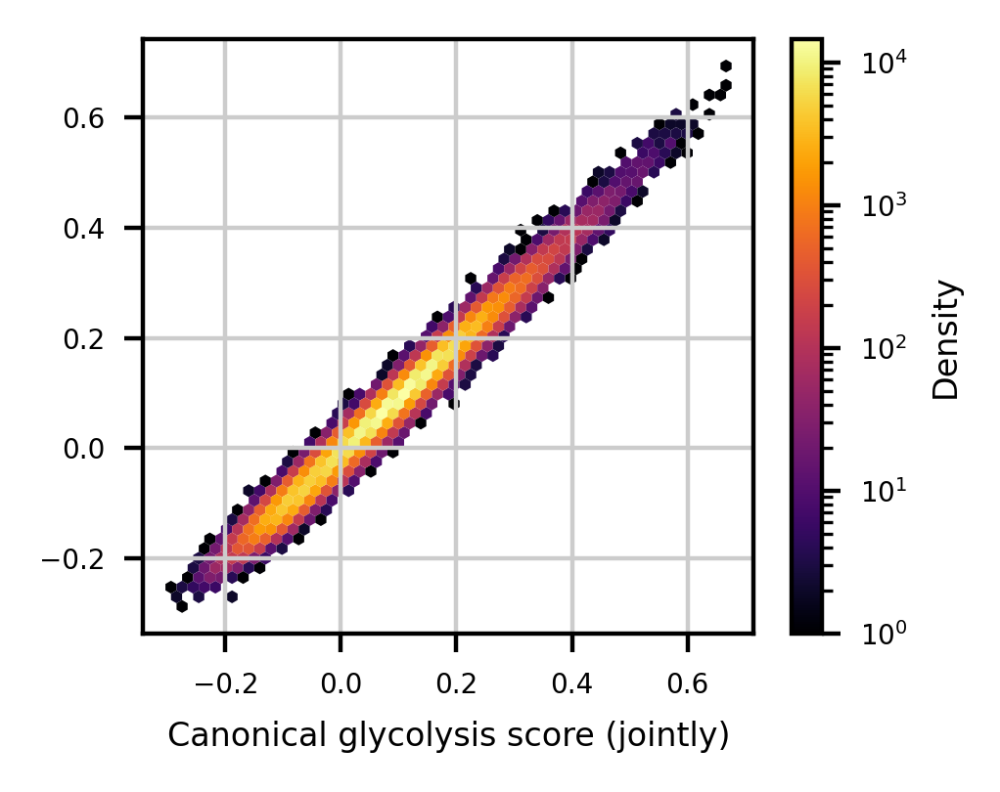

In [436]:
with plt.rc_context({'figure.figsize' : (2.5,2), 'font.size': 5, 'xtick.labelsize' : 5, 'ytick.labelsize' : 5, 'legend.fontsize' : 5, 'axes.labelsize' : 6}):
    plt.hexbin(adata_ref.obs['GO_canonical_glycolysis_joint2'], adata_ref.obs['GO_canonical_glycolysis_joint'], gridsize=50, cmap='inferno', edgecolors='none', bins='log')
    plt.xlabel('Canonical glycolysis score (jointly rs=100)')
    plt.xlabel('Canonical glycolysis score (jointly)')
    plt.colorbar(label='Density')
    plt.show()

In [437]:
adata_ref.write_h5ad('../../ext/ref_cortical-neuron_Braun-Eze-Bhaduri-Wang.h5ad')

## Transfer the integrated clustering label to the organoid cortical neurons

In [5]:
adata = sc.read_h5ad('../../data/phase3_final_0516/ZH_processed_cleanup.h5ad')
adata = adata[adata.obs['annot_level_2']=='Dorsal Telencephalic Neuron',:]
adata.shape

(518082, 36842)

In [6]:
from scipy import sparse

adata.layers['counts_raw'] = adata.layers['counts'].copy()
idx_i, idx_j, x = sparse.find(adata.layers['counts_lengthnorm'])
x = np.round(x)
counts_int = sparse.csr_matrix((x, (idx_i, idx_j)), shape=adata.shape)
adata.layers['counts'] = counts_int
adata.X = counts_int.copy()

In [7]:
adata.write_h5ad('../../data/phase3_final_0516/ZH_processed_cleanup_cortical-neurons.h5ad')

### scPoli-based label transfer

In [ ]:
adata = sc.read_h5ad('../../data/phase3_final_0516/ZH_processed_cleanup_cortical-neurons.h5ad')

In [8]:
adata_scpoli = adata.copy()

In [9]:
import scvi
import scarches

Global seed set to 0
 captum (see https://github.com/pytorch/captum).


In [11]:
adata_ref = sc.read_h5ad('../../ext/ref_cortical-neuron_Braun-Eze-Bhaduri-Wang_scpoli.h5ad')

In [13]:
model = scvi.model.SCVI
model_path = '../../ext/models_cN_joint/scvi/model.pt'
model.prepare_query_anndata(adata_scpoli, model_path)
adata_scpoli.obs['pred_type'] = 'unknown'
adata_scpoli.obs['pred_cl_idx'] = 'unknown'

INFO     File ../../ext/models_cN_joint/scvi/model.pt/model.pt already downloaded                                  
INFO     Found 97.56666666666666% reference vars in query data.                                                    


In [18]:
adata_scpoli.obs['sample'] = adata_scpoli.obs['batch'].copy()

In [19]:
model = scarches.models.scPoli
model_path = '../../ext/models_cN_joint/scpoli'
vae = model.load(model_path, adata_ref)
vae_q = model.load_query_data(
    adata=adata_scpoli,
    reference_model=vae,
    labeled_indices=[],
)

AnnData object with n_obs × n_vars = 401443 × 3000
    obs: 'dataset', 'individual', 'sample', 'stage', 'age', 'label', '_scvi_batch', '_scvi_labels', 'pred_stage', 'pred_class', 'pred_subclass', 'pred_type', 'conditions_combined', 'pred_cl_idx', 'louvain_scpoli_res10', 'louvain_scpoli_res1'
    var: 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: '_scvi_manager_uuid', '_scvi_uuid', 'dataset_colors', 'hvg', 'individual_colors', 'louvain', 'neighbors', 'stage_colors', 'umap'
    obsm: 'X_scpoli', 'X_scvi', 'X_umap', 'X_umap_scpoli', 'X_umap_scvi'
    layers: 'counts', 'lognorm'
    obsp: 'connectivities', 'distances'
Embedding dictionary:
 	Num conditions: [254]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 3000 512 10
	Mean/Var Layer in/out: 512 20
Decoder Architecture:
	First Layer in, out and cond:  20 512 10
	Output Layer in/out:  512 3000 

Embedding dictionary:
 	Num conditions: [56

In [20]:
vae_q.train(
    n_epochs=30,
    pretraining_epochs=20,
    eta=10,
    batch_size = 8192
)

The missing labels are: {'unknown'}
Therefore integer value of those labels is set to -1
The missing labels are: {'unknown'}
Therefore integer value of those labels is set to -1
The missing labels are: {'unknown'}
Therefore integer value of those labels is set to -1
The missing labels are: {'unknown'}
Therefore integer value of those labels is set to -1
The missing labels are: {'unknown'}
Therefore integer value of those labels is set to -1
The missing labels are: {'unknown'}
Therefore integer value of those labels is set to -1
The missing labels are: {'unknown'}
Therefore integer value of those labels is set to -1
The missing labels are: {'unknown'}
Therefore integer value of those labels is set to -1
Initializing dataloaders
Starting training
 |█████████████-------| 66.7%  - val_loss: 1284.03 - val_cvae_loss: 1284.03
Initializing unlabeled prototypes with Leiden with an unknown number of  clusters.
Clustering succesful. Found 25 clusters.
 |████████████████████| 100.0%  - val_loss: 1

In [21]:
vae_q.save("models_scarches_corticalN/scpoli")

In [22]:
adata.obsm['X_scpoli_cN'] = vae_q.get_latent(adata_scpoli, mean=True)

In [253]:
wknn_scpoli_q2r = wknn.get_wknn(ref = adata_ref.obsm['X_scpoli'],
                                query = adata.obsm['X_scpoli_cN'],
                                k = 50,
                                query2ref = True,
                                ref2query = False,
                                weighting_scheme = "jaccard_square")

Failed calling cuML. Falling back to neighborhood estimation using CPU with pynndescent
Failed calling cuML. Falling back to neighborhood estimation using CPU with pynndescent


In [255]:
df_labs_scpoli = { 'stage' : wknn.transfer_labels(adata_ref, adata, wknn_scpoli_q2r, label_key='stage'),
                   'pred_stage' : wknn.transfer_labels(adata_ref, adata, wknn_scpoli_q2r, label_key='pred_stage'),
                   'pred_type' : wknn.transfer_labels(adata_ref, adata, wknn_scpoli_q2r, label_key='pred_type'),
                   'pred_cl_idx' : wknn.transfer_labels(adata_ref, adata, wknn_scpoli_q2r, label_key='pred_cl_idx'),
                   'pred_louvain_res1' : wknn.transfer_labels(adata_ref, adata, wknn_scpoli_q2r, label_key='louvain_scpoli_res1'),
                   'pred_louvain_res10' : wknn.transfer_labels(adata_ref, adata, wknn_scpoli_q2r, label_key='louvain_scpoli_res10')
                 }

In [256]:
adata.obs['stage_scpoli'] = df_labs_scpoli['stage']['best_label']
adata.obs['pred_stage_scpoli'] = df_labs_scpoli['pred_stage']['best_label']
adata.obs['pred_type_scpoli'] = df_labs_scpoli['pred_type']['best_label']
adata.obs['pred_cl_idx_scpoli'] = df_labs_scpoli['pred_cl_idx']['best_label']
adata.obs['pred_louvain_res1_scpoli'] = df_labs_scpoli['pred_louvain_res1']['best_label']
adata.obs['pred_louvain_res10_scpoli'] = df_labs_scpoli['pred_louvain_res10']['best_label']

In [257]:
adata.write_h5ad('../../data/phase3_final_0516/ZH_processed_cleanup_cortical-neurons.h5ad')

### Correlation-based label transfer

In [5]:
adata = sc.read_h5ad('../../data/phase3_final_0516/ZH_processed_cleanup_cortical-neurons.h5ad')

In [6]:
adata_ref_cl = sc.read_h5ad('../../ext/ref_cortical-neuron_Braun-Eze-Bhaduri-Wang_scpoli_cluster-average.h5ad')

In [51]:
from scipy.sparse import csr_matrix
shared_genes = np.intersect1d(adata.var_names, adata_ref_cl.var_names[adata_ref_cl.var['highly_variable']])
ranked_avg_cl = util.rankMatrix_nonzero(adata_ref_cl[:,shared_genes].X.T)
ranked_avg_cl.eliminate_zeros()

In [52]:
ranked_X = util.rankMatrix_nonzero(adata[:,shared_genes].X.T)

In [53]:
cor2avg_spearman = util.corSparse(ranked_X, ranked_avg_cl)
maxcorr_meta = adata_ref_cl.obs.iloc[np.array(np.argmax(cor2avg_spearman, axis=1)).flatten(),:].set_axis(adata.obs_names, axis=0)

In [34]:
maxcorr_meta.head()

,dataset,individual,sample,stage,age,label,_scvi_batch,_scvi_labels,pred_stage,pred_class,pred_subclass,pred_type,conditions_combined,pred_cl_idx,louvain_scpoli_res10,louvain_scpoli_res1
homosapiens_hindbrain_2020_bdrhapsodywholetranscriptomeanalysis_andersenjimena_001_d10_1016_j_cell_2020_11_017_761,"Bhaduri, 2021",GW20_34,GW20_34_PFCVZ,Second_trimester,Second_trimester,Neuron_35,25.850970,0.0,Second_trimester,Neuron,Glutamatergic neuron,EN-Newborn,GW20_34_PFCVZ,31,25,3
homosapiens_hindbrain_2020_bdrhapsodywholetranscriptomeanalysis_andersenjimena_001_d10_1016_j_cell_2020_11_017_839,"Bhaduri, 2021",GW25,GW25_ParMZ,Second_trimester,Second_trimester,Neuron_22,27.000756,0.0,Second_trimester,Neuron,Glutamatergic neuron,EN-Newborn,GW25_ParMZ,32,144,4
homosapiens_hindbrain_2020_bdrhapsodywholetranscriptomeanalysis_andersenjimena_001_d10_1016_j_cell_2020_11_017_1235,"Bhaduri, 2021",GW25,GW20_34_hypo,Second_trimester,Second_trimester,Neuron_22,25.924528,0.0,Second_trimester,Neuron,Glutamatergic neuron,EN-Newborn,GW20_34_hypo,15,174,16
homosapiens_hindbrain_2020_bdrhapsodywholetranscriptomeanalysis_andersenjimena_001_d10_1016_j_cell_2020_11_017_1239,"Bhaduri, 2021",GW18_2,GW19_2_SS,Second_trimester,Second_trimester,Neuron_33,25.171942,0.0,Second_trimester,Neuron,Glutamatergic neuron,EN-Newborn,GW19_2_SS,31,139,3
homosapiens_hindbrain_2020_bdrhapsodywholetranscriptomeanalysis_andersenjimena_001_d10_1016_j_cell_2020_11_017_1608,"Bhaduri, 2021",CS20,CS20_midbrain2,Second_trimester,Second_trimester,Neuron_34,22.813392,0.0,Second_trimester,Neuron,Glutamatergic neuron,EN-Newborn,CS20_midbrain2,37,159,3


In [259]:
adata.obs['stage_corr'] = maxcorr_meta['stage']
adata.obs['pred_stage_corr'] = maxcorr_meta['pred_stage']
adata.obs['pred_type_corr'] = maxcorr_meta['pred_type']
adata.obs['pred_cl_idx_corr'] = maxcorr_meta['pred_cl_idx']
adata.obs['pred_louvain_res1_corr'] = maxcorr_meta['louvain_scpoli_res1']
adata.obs['pred_louvain_res10_corr'] = maxcorr_meta['louvain_scpoli_res10']

In [56]:
stages_ordered = ['First_trimester','Second_trimester','Third_trimester','Infancy']
pd.crosstab(adata.obs['stage_scpoli'], adata.obs['stage_corr']).loc[stages_ordered,stages_ordered]

stage_corr,First_trimester,Second_trimester,Third_trimester,Infancy
stage_scpoli,,,,
First_trimester,15096,62515,0,2
Second_trimester,70478,369345,2,25
Third_trimester,39,328,0,0
Infancy,25,224,0,0


In [57]:
pd.crosstab(adata.obs['pred_cl_idx_scpoli'], adata.obs['pred_cl_idx_corr'])

pred_cl_idx_corr,0,1,2,3,4,5,7,8,10,11,...,91,94,95,106,108,125,134,155,158,160
pred_cl_idx_scpoli,,,,,,,,,,,,,,,,,,,,,
0,285,2,1,2,22,11,38,99,125,16,...,800,1,0,0,0,1,0,0,0,0
1,62,172,40,3,913,1199,1,3,127,2,...,23,0,0,0,0,0,0,0,0,0
2,0,53,83,0,41,582,0,0,2,1,...,2,0,0,0,0,0,0,0,0,0
3,633,14,16,18,17,36,1,32,9,55,...,101,0,4,0,1,15,1,1,1,0
4,4,7,0,0,171,17,1,0,118,0,...,5,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
131,1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
133,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
135,11,0,0,0,0,0,0,0,1,1,...,0,0,0,0,0,0,0,0,0,0


In [58]:
pd.crosstab(adata.obs['pred_type_scpoli'], adata.obs['pred_type_corr'])

pred_type_corr,EN-IT-Immature,EN-L2_3-IT,EN-L4-IT,EN-L5-IT,EN-L6-CT,EN-L6-IT,EN-L6b,EN-Newborn,EN-Non-IT-Immature
pred_type_scpoli,,,,,,,,,
EN-IT-Immature,15694,1,0,0,0,71,7,29428,80
EN-L2_3-IT,108,0,0,0,0,0,0,79,0
EN-L4-IT,80,0,0,0,0,0,0,7,0
EN-L5-ET,122,0,0,0,0,0,1,14,2
EN-L5-IT,1808,0,0,0,0,2,0,456,1
EN-L5_6-NP,513,0,0,0,0,0,41,57,17
EN-L6-CT,60,0,0,0,0,0,6,12,1
EN-L6-IT,188,0,0,0,0,1,0,16,0
EN-L6b,17662,0,1,0,0,1,11881,7915,573


In [260]:
adata.write_h5ad('../../data/phase3_final_0516/ZH_processed_cleanup_cortical-neurons.h5ad')

### Check which transferred labels to use based on the transferred type

In [5]:
adata = sc.read_h5ad('../../data/phase3_final_0516/ZH_processed_cleanup_cortical-neurons.h5ad')

In [6]:
adata_ref = sc.read_h5ad('../../ext/ref_cortical-neuron_Braun-Eze-Bhaduri-Wang.h5ad')

In [102]:
adata_ref_scpoli = sc.read_h5ad('../../ext/ref_cortical-neuron_Braun-Eze-Bhaduri-Wang_scpoli.h5ad')

In [8]:
adata_wang = sc.read_h5ad(
    '/links/groups/treutlein/USERS/zhisong_he/Work/public_datasets/Wang_Kriegstein_bioRxiv_2024_neocortex_development_scmultiome/GEX.h5ad'
)

In [11]:
adata_wang_imN = adata_wang[np.isin(adata_wang.obs['type'], ['EN-IT-Immature','EN-Non-IT-Immature']),:]

In [12]:
sc.tl.rank_genes_groups(adata_wang_imN, 'type', method='wilcoxon')

In [49]:
df_markers = sc.get.rank_genes_groups_df(adata_wang_imN, group=None).loc[lambda x: (x['pvals_adj']<0.01) & (x['logfoldchanges']>0),:]
df_markers.head()

,group,names,scores,logfoldchanges,pvals,pvals_adj
0,EN-IT-Immature,TAFA1,108.144501,4.195262,0.0,0.0
1,EN-IT-Immature,DLGAP2,95.591881,3.004269,0.0,0.0
2,EN-IT-Immature,SYBU,89.696686,2.499679,0.0,0.0
3,EN-IT-Immature,CELF2,89.503998,1.173268,0.0,0.0
4,EN-IT-Immature,MEF2C,89.460625,1.752795,0.0,0.0


In [50]:
df_markers['group'].value_counts()

EN-IT-Immature        3116
EN-Non-IT-Immature    2376
Name: group, dtype: int64

In [37]:
pct_in_out = [
    pd.DataFrame({ 'group' : x,
                   'names' : adata_wang_imN.var_names,
                   'pct_in' : np.array((adata_wang_imN[adata_wang_imN.obs['type']==x,:].X > 0).mean(axis=0)).flatten(),
                   'pct_out' : np.array((adata_wang_imN[adata_wang_imN.obs['type']!=x,:].X > 0).mean(axis=0)).flatten()
                 })
    for x in adata_wang_imN.obs['type'].unique()
]

In [53]:
df_markers = df_markers.merge(pd.concat(pct_in_out), on=['group','names'])

In [60]:
df_markers_sig = df_markers.loc[lambda x: ((x['pct_in']-x['pct_out']>0.2) & (x['pct_out']<0.1)),:]
[ df_markers_sig.loc[lambda x:x['group']==y,:].head() for y in df_markers_sig['group'].unique() ]

[              group      names     scores  logfoldchanges  pvals  pvals_adj  \
 37   EN-IT-Immature      GLIS3  65.092346        3.509073    0.0        0.0   
 44   EN-IT-Immature      KCNH5  62.913830        3.616525    0.0        0.0   
 83   EN-IT-Immature  PTCHD1-AS  50.874039        3.048758    0.0        0.0   
 92   EN-IT-Immature      KLHL4  48.938343        2.846836    0.0        0.0   
 149  EN-IT-Immature     PDZRN3  40.691483        2.998154    0.0        0.0   
 
        pct_in   pct_out  
 37   0.570208  0.098602  
 44   0.536389  0.073064  
 83   0.459931  0.084617  
 92   0.448681  0.086542  
 149  0.365347  0.061005  ,
                    group      names     scores  logfoldchanges  pvals  \
 3119  EN-Non-IT-Immature     BCL11B  88.806557        4.844753    0.0   
 3125  EN-Non-IT-Immature      GRIK3  76.989250        4.961067    0.0   
 3144  EN-Non-IT-Immature     HS3ST4  55.744003        3.445183    0.0   
 3145  EN-Non-IT-Immature  ZFPM2-AS1  55.354946        3.53

In [70]:
sc.tl.score_genes(adata,
                  gene_list=df_markers_sig.loc[df_markers_sig['group']=='EN-IT-Immature','names'],
                  score_name='score_EN_IT_Immature')
sc.tl.score_genes(adata,
                  gene_list=df_markers_sig.loc[df_markers_sig['group']=='EN-Non-IT-Immature','names'],
                  score_name='score_EN_Non_IT_Immature')

In [90]:
adata.obs['diff_EN_IT_Non_IT'] = adata.obs['score_EN_IT_Immature'] - adata.obs['score_EN_Non_IT_Immature']

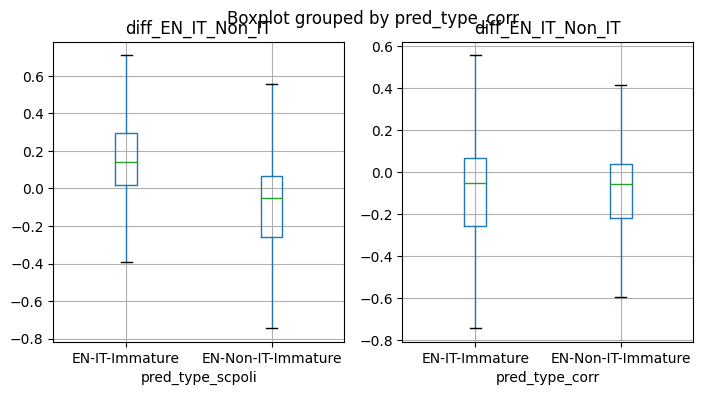

In [60]:
fig, ax = plt.subplots(1,2, figsize=(8,4))

idx = (np.isin(adata.obs['pred_type_corr'], ['EN-IT-Immature']) & np.isin(adata.obs['pred_type_scpoli'], ['EN-IT-Immature','EN-Non-IT-Immature']))
df = adata.obs.loc[idx,:]
df['pred_type_scpoli'] = df['pred_type_scpoli'].cat.remove_unused_categories()
df['pred_type_corr'] = df['pred_type_corr'].cat.remove_unused_categories()
df.boxplot(column=['diff_EN_IT_Non_IT'], by='pred_type_scpoli', sym='', ax=ax[0])

idx = (np.isin(adata.obs['pred_type_corr'], ['EN-IT-Immature','EN-Non-IT-Immature']) & np.isin(adata.obs['pred_type_scpoli'], ['EN-Non-IT-Immature']))
df = adata.obs.loc[idx,:]
df['pred_type_scpoli'] = df['pred_type_scpoli'].cat.remove_unused_categories()
df['pred_type_corr'] = df['pred_type_corr'].cat.remove_unused_categories()
df.boxplot(column=['diff_EN_IT_Non_IT'], by='pred_type_corr', sym='', ax=ax[1])

fig.show()

# DE analysis

## Prepare data for the DE analysis

In [33]:
adata = sc.read_h5ad('../../data/phase3_final_0516/ZH_processed_cleanup_cortical-neurons.h5ad')

In [312]:
adata.layers['lognorm_10k'] = (adata.layers['lognorm'].expm1() / 100).log1p()
[ adata.layers['lognorm'].max(), adata.layers['lognorm_10k'].max() ]

[13.416902, 8.811878868771773]

In [313]:
meta_org_full = adata.obs.copy()
adata.X = adata.layers['lognorm_10k'].copy()
adata.obs = pd.DataFrame({'datatype' : np.repeat('organoid',adata.shape[0]),
                          'dataset' : adata.obs['publication_protocol'],
                          'individual' : adata.obs['individual'],
                          'sample' : adata.obs['bio_sample'],
                          'stage' : adata.obs['pred_stage_scpoli'],
                          'age' : adata.obs['organoid_age_weeks'],
                          'protocol' : adata.obs['assay_differentiation'],
                          'publication' : adata.obs['publication'],
                          'sc_method' : adata.obs['assay_sc'],
                          'cluster1' : adata.obs['pred_cl_idx_scpoli'],
                          'cluster2' : adata.obs['pred_louvain_res1_scpoli'],
                          'cluster3' : adata.obs['pred_louvain_res10_scpoli'],
                          'cluster4' : adata.obs['pred_cl_idx_corr'],
                          'cluster5' : adata.obs['pred_louvain_res1_corr'],
                          'cluster6' : adata.obs['pred_louvain_res10_corr']
                         }, index = adata.obs_names)

In [314]:
adata_ref = sc.read_h5ad('../../ext/ref_cortical-neuron_Braun-Eze-Bhaduri-Wang.h5ad')

In [315]:
adata_ref_scpoli = sc.read_h5ad('../../ext/ref_cortical-neuron_Braun-Eze-Bhaduri-Wang_scpoli.h5ad')

In [316]:
meta_ref_full = adata_ref.obs.copy()
adata_ref.obs = pd.DataFrame({'datatype' : np.repeat('primary',adata_ref.shape[0]),
                              'dataset' : adata_ref.obs['dataset'],
                              'individual' : adata_ref.obs['individual'],
                              'sample' : adata_ref.obs['sample'],
                              'stage' : adata_ref.obs['stage'],
                              'age' : adata_ref.obs['age'],
                              'protocol' : np.repeat('primary',adata_ref.shape[0]),
                              'publication' : adata_ref.obs['dataset'],
                              'sc_method' : "",
                              'cluster1' : adata_ref_scpoli.obs['pred_cl_idx'],
                              'cluster2' : adata_ref_scpoli.obs['louvain_scpoli_res1'],
                              'cluster3' : adata_ref_scpoli.obs['louvain_scpoli_res10'],
                              'cluster4' : adata_ref_scpoli.obs['pred_cl_idx'],
                              'cluster5' : adata_ref_scpoli.obs['louvain_scpoli_res1'],
                              'cluster6' : adata_ref_scpoli.obs['louvain_scpoli_res10']
                             }, index = adata_ref.obs_names)

In [317]:
[adata.shape,adata_ref.shape]

[(518082, 36842), (401443, 19808)]

In [318]:
adata_joint = anndata.concat([adata, adata_ref])
adata_joint.obs['cluster1'] = adata_joint.obs['cluster1'].astype('str').astype('int').astype('category')
adata_joint.obs['cluster2'] = adata_joint.obs['cluster2'].astype('str').astype('int').astype('category')
adata_joint.obs['cluster3'] = adata_joint.obs['cluster3'].astype('str').astype('int').astype('category')
adata_joint.obs['cluster4'] = adata_joint.obs['cluster4'].astype('str').astype('int').astype('category')
adata_joint.obs['cluster5'] = adata_joint.obs['cluster5'].astype('str').astype('int').astype('category')
adata_joint.obs['cluster6'] = adata_joint.obs['cluster6'].astype('str').astype('int').astype('category')
adata_joint.shape

(919525, 19080)

In [17]:
adata_joint.X = adata_joint.layers['counts'].copy()
sc.pp.normalize_total(adata_joint, target_sum=1e4)
sc.pp.log1p(adata_joint)

In [30]:
datasets2consider = adata_joint.obs['dataset'].value_counts()[lambda x: x>500].index
adata_joint = adata_joint[np.isin(adata_joint.obs['dataset'], datasets2consider),:]

In [37]:
adata_joint.shape

(918752, 19080)

In [38]:
msigdb_glycolysis = np.array(pd.read_csv('../../ext/HALLMARK_GLYCOLYSIS.v2023.2.Hs.tsv', sep='\t', header=None, index_col=0).loc['GENE_SYMBOLS',1].split(','))
sc.tl.score_genes(adata_joint, msigdb_glycolysis, score_name='Hallmark_Glycolysis')
adata_joint.obs['bin_Glycolysis'] = pd.cut(adata_joint.obs['Hallmark_Glycolysis'], bins=10)

In [39]:
adata_joint.obs['age'] = adata_joint.obs['age'].astype('str')

In [40]:
adata_joint.obs['bin_Glycolysis'] = adata_joint.obs['bin_Glycolysis'].astype('str').astype('category')

In [41]:
adata_joint.write_h5ad('../../data/phase3_final_0516/cortical_neuron_HNOCA_refs.h5ad')

## The function for DE test

In [5]:
from scipy.sparse import issparse
from scipy.stats import f
from statsmodels.formula.api import ols
from statsmodels.stats.anova import anova_lm
from joblib import Parallel, delayed
import multiprocessing
from tqdm import tqdm

def anova(e, group, covar=None, return_coef_group=None):
    if issparse(e):
        e = e.todense()
    e = np.array(e).flatten()
    
    if covar is None:
        m0 = ols('e ~ 1', data=pd.DataFrame({'e': e})).fit()
        m1 = ols('e ~ zz_group', data=pd.DataFrame({'e': e, 'zz_group': group})).fit()
    else:
        data = pd.DataFrame({'e': e, **covar, 'zz_group': group})
        m0 = ols('e ~ '+" + ".join(covar.columns), data=data).fit()
        m1 = ols('e ~ '+" + ".join(covar.columns)+' + zz_group', data=data).fit()
    
    a0 = anova_lm(m0)
    a1 = anova_lm(m1)
    a01 = anova_lm(m0, m1)
    p1 = a01.loc[:, 'Pr(>F)'].iloc[-1]
    p2 = 1-np.abs(0.5 - f.cdf(a0.loc['Residual','mean_sq']/a1.loc['Residual','mean_sq'], a0.loc['Residual','df'], a1.loc['Residual','df']))*2
    
    var_tot = a0['sum_sq'].sum()
    var_covar = a0.iloc[:-1]['sum_sq'].sum()
    var_g = a1.loc['zz_group', 'sum_sq']
    
    if return_coef_group is not None and return_coef_group in pd.Series(group).unique() and f'zz_group[T.{return_coef_group}]' in m1.params.index:
        coef_g = m1.params[f'zz_group[T.{return_coef_group}]']
    else:
        coef_g = np.nan
    
    return (var_g, var_covar, var_tot, p1, p2, coef_g)

def ancova_group_test(expr, group, covar=None, num_threads=1, return_coef_group=None, var_names=None):
    if not isinstance(group, pd.Series):
        group = pd.Series(group)
    idx = np.where(~group.isnull())[0]
    expr = expr[idx,:]
    group = group[idx]
    if covar is not None:
        covar = pd.DataFrame(covar).iloc[idx,:]
    
    if group.dtype.name != 'category':
        group = group.astype('category')
    group = group.cat.remove_unused_categories()
    g_lev = np.array(pd.Series(group).astype('category').cat.categories)
    if return_coef_group is not None and return_coef_group in g_lev:
        g_lev = np.concatenate([ g_lev[g_lev != return_coef_group], [return_coef_group] ])
        group = group.cat.reorder_categories(g_lev)
    
    num_cores = min(num_threads, multiprocessing.cpu_count())
    if num_cores > 1:
        results = Parallel(n_jobs=num_cores)(
            delayed(anova)(expr[:,i], group, covar, return_coef_group) for i in range(expr.shape[1])
        )
    else:
        results = list()
        for i in tqdm(range(expr.shape[1])):
            results.append(anova(expr[:,i], group, covar=covar, return_coef_group=return_coef_group))
    
    df_res = pd.DataFrame(results, columns=["var_group", "var_covar", "var_total", "p_ANCOVA", "p_Resi", "coef"])
    if var_names is not None and len(var_names) == df_res.shape[0]:
        df_res.index = var_names
    else:
        df_res.index = pd.RangeIndex(start=0, stop=expr.shape[1], step=1)
    return df_res

## Perform the DE analysis and look into the results

In [68]:
pd.crosstab(adata_joint.obs['cluster5'], adata_joint.obs['datatype'])

datatype,organoid,primary
cluster5,,
0,11144,30297
1,427,26453
2,10392,26158
3,151124,25431
4,29635,25135
5,73610,24758
6,151,23457
7,6129,23285
8,14994,21545


In [69]:
cl2consider = adata_joint.obs['cluster5'].cat.categories[(pd.crosstab(adata_joint.obs['cluster5'], adata_joint.obs['datatype'])>100).sum(axis=1)==2]
[ len(cl2consider), len(adata_joint.obs['cluster5'].cat.categories) ]

[18, 28]

In [70]:
adata_joint2 = adata_joint[np.isin(adata_joint.obs['cluster5'], cl2consider),:].copy()
[adata_joint.shape, adata_joint2.shape]

[(918752, 19080), (851015, 19080)]

In [71]:
pd.concat([ adata_joint.obs['datatype'].value_counts(), adata_joint2.obs['datatype'].value_counts() ], axis=1)

,datatype,datatype
organoid,517309,517229
primary,401443,333786


In [72]:
det_rates_org = (adata_joint[adata_joint.obs['datatype']=='organoid',:].X>0).mean(axis=0)
det_rates_pri = (adata_joint[adata_joint.obs['datatype']=='primary',:].X>0).mean(axis=0)

In [73]:
idx_expressed = ((det_rates_org > 0.01) | (det_rates_pri > 0.01))
np.sum(idx_expressed)

12992

In [74]:
adata_joint2 = adata_joint2[:,idx_expressed].copy()

In [75]:
adata_joint2.write_h5ad('../../data/phase3_final_0516/cortical_neuron_HNOCA_refs_filtered.h5ad')

## DE analysis using all cells

In [5]:
adata_joint2 = sc.read_h5ad('../../data/phase3_final_0516/cortical_neuron_HNOCA_refs_filtered.h5ad')

In [76]:
DE_all = ancova_group_test(adata_joint2.X, adata_joint2.obs['datatype'],
                           covar=adata_joint2.obs[['cluster5','bin_Glycolysis']], return_coef_group='organoid', var_names=adata_joint2.var_names,
                           num_threads=10
                          )

In [77]:
from statsmodels.stats.multitest import multipletests
DE_all['padj_Resi'] = multipletests(DE_all['p_Resi'], method='holm')[1]
DE_all.head()

,var_group,var_covar,var_total,p_ANCOVA,p_Resi,coef,padj_Resi
TSPAN6,33.758406,1306.353019,96715.901791,1.845904e-67,0.870765,-0.019229,1.0
DPM1,163.319865,1698.679111,236533.744844,9.027182e-131,0.748703,0.042295,1.0
SCYL3,0.167918,158.081430,43049.547287,6.796145e-02,0.998992,0.001356,1.0
C1orf112,0.046909,157.517897,25410.118038,2.086453e-01,0.999749,0.000717,1.0
FUCA2,0.368506,80.019285,49166.172072,1.148521e-02,0.997670,0.002009,1.0


In [78]:
DE_all.to_csv('DE_cortical_all.tsv', sep='\t')

In [91]:
DE_all.loc[['FOXG1','EMX1','DCX','MAP2','MAPT','NEUROD6','BCL11B','SATB2','SLC17A7','SLC17A6','SLC16A3'],:]

,var_group,var_covar,var_total,p_ANCOVA,p_Resi,coef,padj_Resi
FOXG1,615.613849,48480.472322,7.498285e+05,1.559691e-164,6.858472e-01,-0.082116,1.000000e+00
EMX1,3271.791627,20861.311141,3.632475e+05,0.000000e+00,9.500942e-06,0.189307,1.167761e-01
DCX,6960.921786,36327.472236,8.895169e+05,0.000000e+00,1.580621e-04,0.276126,1.000000e+00
MAP2,3817.640966,151412.700728,9.286927e+05,0.000000e+00,2.317967e-02,-0.204489,1.000000e+00
MAPT,232.654173,84121.903226,7.584346e+05,7.920406e-66,8.739635e-01,-0.050481,1.000000e+00
NEUROD6,4000.957636,156686.348079,1.270489e+06,0.000000e+00,9.705435e-02,0.209341,1.000000e+00
BCL11B,720.177182,218827.123908,7.035605e+05,3.994441e-277,4.931879e-01,0.088816,1.000000e+00
SATB2,28969.721550,316588.948722,9.402314e+05,0.000000e+00,2.220446e-16,-0.563307,2.884804e-12
SLC17A7,6219.292253,22094.848723,3.341721e+05,0.000000e+00,2.220446e-16,0.261002,2.884804e-12
SLC17A6,798.655404,2779.617334,1.018216e+05,0.000000e+00,1.885242e-04,-0.093530,1.000000e+00


In [80]:
pd.Series(np.sign(DE_all['coef'][DE_all['padj_Resi'] < 0.01])).value_counts()

 1.0    449
-1.0    150
Name: coef, dtype: int64

In [85]:
np.array(DE_all.loc[(DE_all['padj_Resi']<0.01) & (DE_all['coef']<0),:].index)

array(['NFIX', 'EPHA3', 'COL9A2', 'NNAT', 'LIMCH1', 'CTNNA2', 'LNX1',
       'SEMA3C', 'DYNC1I2', 'RBFOX1', 'RUNX1T1', 'MEF2C', 'RPL6',
       'SLC26A3', 'NRP1', 'TTC28', 'RPL3', 'WFDC2', 'STMN2', 'EPHB6',
       'CHCHD2', 'PPP1R17', 'RPL19', 'RPL34', 'MDK', 'ST8SIA1', 'RBP1',
       'FRMD4B', 'RPL22', 'STMN1', 'STAG1', 'SATB2', 'RPL21', 'NPY',
       'TUBA1B', 'RPS10', 'LRRC61', 'RPS4Y1', 'CHL1', 'MEIS2', 'RPS15A',
       'HNRNPA1', 'TMOD1', 'RPS6', 'TUBB2B', 'SLC44A5', 'RPS24',
       'RASGEF1B', 'PPFIA2', 'HNRNPA1L2', 'RTN1', 'RPS27A', 'RPL32',
       'RPS3A', 'RPL37', 'BTF3', 'TENM2', 'RPL10', 'RPL7', 'ADGRL3',
       'GPM6A', 'SCN3A', 'PTPRD', 'SORBS2', 'EEF1A1', 'UNC5D', 'NRG1',
       'LRP8', 'TMSB15B', 'COX7A1', 'RPL26', 'RPL9', 'ADGRV1', 'FABP7',
       'FABP5', 'HTRA1', 'RPL27A', 'SCG5', 'TUBA1A', 'TUBA1C', 'POLR2J3',
       'SLC25A6', 'MN1', 'UBB', 'FOS', 'RPS9', 'ENC1', 'MLLT3', 'C1QTNF4',
       'RPL38', 'CTSF', 'ANKRD36C', 'MSRA', 'TTTY14', 'RPS27', 'ZBTB18',
       'NRXN

## DE analysis using all samples but with cell number per dataset balanced

In [6]:
adata_joint2 = sc.read_h5ad('../../data/phase3_final_0516/cortical_neuron_HNOCA_refs_filtered.h5ad')

In [6]:
adata_joint2.obs['dataset'][adata_joint2.obs['datatype']=='organoid'].value_counts()

Paulsen, 2022: Velasco, 2019 (doi: 10.1038/s41586-019-1289-x)                   135806
Uzquiano, 2022: Velasco, 2019 (doi: 10.1038/s41586-019-1289-x)                  100287
Velasco, 2019: Velasco, 2019 (doi: 10.1038/s41586-019-1289-x)                    78826
Bowles, 2021: Yoon, 2019 (doi: 10.1038/s41592-018-0255-0)                        67074
Bhaduri, 2020: Velasco, 2019 (doi: 10.1038/s41586-019-1289-x)                    23598
Uzquiano, 2022: Quadrato, 2017 (doi: 10.1038/protex.2017.049)                    21744
Kanton, 2019: Lancaster, 2014 (doi: 10.1038/nprot.2014.158)                      21328
Bhaduri, 2020: Bhaduri, 2020 (doi: 10.1038/s41586-020-1962-0); directed          16178
Samarasinghe, 2021: Watanabe, 2017 (doi: 10.1016/j.celrep.2017.09.047)           13214
Yoon, 2019: Yoon, 2019 (doi: 10.1038/s41592-018-0255-0)                           7091
Trujillo, 2019: Trujillo, 2019 (doi: 10.1016/j.stem.2019.08.002)                  5824
Khan, 2020: Pasca, 2015 (doi: 10.1038/nmeth

In [7]:
datasets = adata_joint2.obs['dataset'][adata_joint2.obs['datatype']=='organoid'].value_counts()[lambda x: x>500].index
cap_celln = 10000

In [8]:
dfs_sel = list()
for x in tqdm(datasets):
    df = util.subsample(adata_joint2.obs_names[adata_joint2.obs['dataset']==x], size=cap_celln, N=20, use_all_attempt=True)
    dfs_sel.append(df)

100%|██████████| 20/20 [10:18<00:00, 30.91s/it]  


In [14]:
df_sel_org = pd.concat(dfs_sel)
df_sel_org.shape

(517229, 20)

In [15]:
df_sel_org.sum(axis=0)

0     129174
1     129174
2     129174
3     129174
4     129174
5     129174
6     129174
7     129174
8     129174
9     129174
10    129174
11    129174
12    129174
13    129174
14    129174
15    129174
16    129174
17    129174
18    129174
19    129174
dtype: int64

In [16]:
adata_joint2.obs['dataset'][adata_joint2.obs['datatype']=='primary'].value_counts()

Bhaduri, 2021                                                                   195245
Braun, 2023                                                                      60520
Wang, 2024                                                                       57440
Eze, 2021                                                                        20581
Bhaduri, 2020: Bhaduri, 2020 (doi: 10.1038/s41586-020-1962-0); directed              0
Pellegrini, 2020: Pellegrini, 2020 (doi: 10.1126/science.aaz5626); hCO               0
Vertesy, 2022: Esk, 2020 (doi: 10.1126/science.abb5390)                              0
Velasco, 2019: Velasco, 2019 (doi: 10.1038/s41586-019-1289-x)                        0
Uzquiano, 2022: Velasco, 2019 (doi: 10.1038/s41586-019-1289-x)                       0
Uzquiano, 2022: Quadrato, 2017 (doi: 10.1038/protex.2017.049)                        0
Trujillo, 2019: Trujillo, 2019 (doi: 10.1016/j.stem.2019.08.002)                     0
Samarasinghe, 2021: Watanabe, 2017 (doi: 10

In [18]:
datasets_pri = adata_joint2.obs['dataset'][adata_joint2.obs['datatype']=='primary'].value_counts()[lambda x: x>500].index
cap_celln_pri = 40000

In [19]:
dfs_sel_pri = list()
for x in tqdm(datasets_pri):
    df = util.subsample(adata_joint2.obs_names[adata_joint2.obs['dataset']==x], size=cap_celln_pri, N=20, use_all_attempt=True)
    dfs_sel_pri.append(df)

100%|██████████| 4/4 [14:17<00:00, 214.25s/it]


In [20]:
df_sel_pri = pd.concat(dfs_sel_pri)
df_sel_pri.shape

(333786, 20)

In [21]:
df_sel_pri.sum(axis=0)

0     140581
1     140581
2     140581
3     140581
4     140581
5     140581
6     140581
7     140581
8     140581
9     140581
10    140581
11    140581
12    140581
13    140581
14    140581
15    140581
16    140581
17    140581
18    140581
19    140581
dtype: int64

In [22]:
df_sel_all = pd.concat([df_sel_org, df_sel_pri]).loc[adata_joint2.obs_names,:]
df_sel_all.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
homosapiens_None_2020_10x3v2_bhaduriaparna_001_d10_1038_s41586_020_1962_0_181158,False,False,False,True,False,True,False,True,True,True,True,False,False,True,True,True,False,True,False,True
homosapiens_None_2020_10x3v2_bhaduriaparna_001_d10_1038_s41586_020_1962_0_195699,False,True,True,False,True,False,False,True,False,True,False,True,True,False,False,True,False,False,False,False
homosapiens_None_2020_10x3v2_bhaduriaparna_001_d10_1038_s41586_020_1962_0_120,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True
homosapiens_None_2020_10x3v2_bhaduriaparna_001_d10_1038_s41586_020_1962_0_1841,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True
homosapiens_None_2020_10x3v2_bhaduriaparna_001_d10_1038_s41586_020_1962_0_2793,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True


In [34]:
df_sel_all.to_csv('DE_cortical_cell_subset_selection.tsv', sep='\t')

In [6]:
df_sel_all = pd.read_csv('DE_cortical_cell_subset_selection.tsv', sep='\t', index_col=0, header=0)
df_sel_all.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
homosapiens_None_2020_10x3v2_bhaduriaparna_001_d10_1038_s41586_020_1962_0_181158,False,False,False,True,False,True,False,True,True,True,True,False,False,True,True,True,False,True,False,True
homosapiens_None_2020_10x3v2_bhaduriaparna_001_d10_1038_s41586_020_1962_0_195699,False,True,True,False,True,False,False,True,False,True,False,True,True,False,False,True,False,False,False,False
homosapiens_None_2020_10x3v2_bhaduriaparna_001_d10_1038_s41586_020_1962_0_120,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True
homosapiens_None_2020_10x3v2_bhaduriaparna_001_d10_1038_s41586_020_1962_0_1841,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True
homosapiens_None_2020_10x3v2_bhaduriaparna_001_d10_1038_s41586_020_1962_0_2793,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True


In [10]:
i = 0
idx = np.array(range(adata_joint2.shape[1])) < 50
DE = ancova_group_test(adata_joint2[df_sel_all.iloc[:,i],idx].X, adata_joint2.obs['datatype'][df_sel_all.iloc[:,i]],
                       covar=adata_joint2.obs.loc[df_sel_all.iloc[:,i],['cluster5','bin_Glycolysis']], return_coef_group='organoid', var_names=adata_joint2.var_names[idx]
                      )

100%|██████████| 50/50 [01:01<00:00,  1.23s/it]


In [11]:
DE.head()

,var_group,var_covar,var_total,p_ANCOVA,p_Resi,coef
TSPAN6,2.851566,486.487875,29295.434873,2.376982e-07,0.980261,-0.009543
DPM1,117.422439,780.723309,74144.294338,5.793878e-96,0.678145,0.061238
SCYL3,0.063666,118.101688,15993.479431,2.983153e-01,0.999937,-0.001426
C1orf112,0.264760,108.598040,10695.288988,9.397911e-03,0.995587,-0.002908
FUCA2,0.015779,30.338717,13579.533252,5.751607e-01,0.999473,-0.000710


In [9]:
DE_sels = Parallel(n_jobs=10)(
    delayed(ancova_group_test)(adata_joint2[df_sel_all.iloc[:,i],:].X,
                               adata_joint2.obs['datatype'][df_sel_all.iloc[:,i]],
                               adata_joint2.obs.loc[df_sel_all.iloc[:,i],['cluster5','bin_Glycolysis']],
                               1,
                               'organoid',
                               adata_joint2.var_names) for i in range(df_sel_all.shape[1])
)

In [10]:
import pickle
with open('DE_cortical_sel.pickle', 'wb') as f:
    pickle.dump(DE_sels, f)

In [8]:
import pickle
with open('DE_cortical_sel.pickle', 'rb') as f:
    DE_sels = pickle.load(f)

In [6]:
DE_sels[0]

,var_group,var_covar,var_total,p_ANCOVA,p_Resi,coef
TSPAN6,2.851566,486.487875,29295.434873,2.376982e-07,0.980261,-0.009543
DPM1,117.422439,780.723309,74144.294338,5.793878e-96,0.678145,0.061238
SCYL3,0.063666,118.101688,15993.479431,2.983153e-01,0.999937,-0.001426
C1orf112,0.264760,108.598040,10695.288988,9.397911e-03,0.995587,-0.002908
FUCA2,0.015779,30.338717,13579.533252,5.751607e-01,0.999473,-0.000710
...,...,...,...,...,...,...
TBCE,307.330875,739.558788,19344.999508,0.000000e+00,0.000015,-0.099071
ARHGAP11B,0.973026,4.783445,3107.522475,3.652445e-20,0.935851,-0.005574
CDR1,0.020097,10.019327,10087.299989,4.632976e-01,0.999645,0.000801
PRRC2B,155.243585,9668.867411,159410.621631,8.377761e-63,0.788396,-0.070412


In [9]:
from statsmodels.stats.multitest import multipletests
DE_sels = [ pd.concat([x, pd.DataFrame({'padj':multipletests(x['p_Resi'], method='holm')[1]},index=x.index)], axis=1) for x in DE_sels ]
DE_sels[0]

,var_group,var_covar,var_total,p_ANCOVA,p_Resi,coef,padj
TSPAN6,2.851566,486.487875,29295.434873,2.376982e-07,0.980261,-0.009543,1.000000
DPM1,117.422439,780.723309,74144.294338,5.793878e-96,0.678145,0.061238,1.000000
SCYL3,0.063666,118.101688,15993.479431,2.983153e-01,0.999937,-0.001426,1.000000
C1orf112,0.264760,108.598040,10695.288988,9.397911e-03,0.995587,-0.002908,1.000000
FUCA2,0.015779,30.338717,13579.533252,5.751607e-01,0.999473,-0.000710,1.000000
...,...,...,...,...,...,...,...
TBCE,307.330875,739.558788,19344.999508,0.000000e+00,0.000015,-0.099071,0.194511
ARHGAP11B,0.973026,4.783445,3107.522475,3.652445e-20,0.935851,-0.005574,1.000000
CDR1,0.020097,10.019327,10087.299989,4.632976e-01,0.999645,0.000801,1.000000
PRRC2B,155.243585,9668.867411,159410.621631,8.377761e-63,0.788396,-0.070412,1.000000


In [14]:
np.array([ pd.Series(np.sign(x['coef'][(x['padj']<0.05) & (np.abs(x['coef'])>np.log(1.2))])).value_counts(sort=False) for x in DE_sels ])

array([[137, 103],
       [136, 103],
       [134, 102],
       [133, 101],
       [132, 100],
       [135, 101],
       [134, 103],
       [136, 101],
       [134, 102],
       [130, 103],
       [137, 101],
       [138, 103],
       [134, 103],
       [135, 102],
       [138, 103],
       [133,  98],
       [134, 102],
       [136, 104],
       [134, 104],
       [135, 102]])

In [10]:
is_DE = pd.DataFrame(np.transpose(np.array([ ((x['padj']<0.05) & (np.abs(x['coef'])>np.log(1.2))) for x in DE_sels])), index=DE_sels[0].index)
is_DE.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
TSPAN6,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
DPM1,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
SCYL3,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
C1orf112,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
FUCA2,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False


In [16]:
np.sum(is_DE.mean(axis=1)>0.8)

231

In [11]:
coefs_sels = pd.DataFrame(np.transpose(np.array([x['coef'] for x in DE_sels])), index=DE_sels[0].index)
coefs_sels.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
TSPAN6,-0.009543,-0.009850,-0.009936,-0.010015,-0.011769,-0.010108,-0.010252,-0.009450,-0.009983,-0.009334,-0.009591,-0.010774,-0.010708,-0.011089,-0.006290,-0.009846,-0.009125,-0.009157,-0.008530,-0.008229
DPM1,0.061238,0.057311,0.059071,0.063594,0.060820,0.061277,0.059871,0.061930,0.058191,0.058366,0.059225,0.062344,0.058488,0.058513,0.060321,0.059973,0.059207,0.060521,0.058881,0.063522
SCYL3,-0.001426,-0.000695,-0.001283,-0.000222,-0.001276,0.000016,-0.001778,-0.000651,0.000552,0.000175,0.000413,-0.002228,-0.000634,-0.000153,-0.000849,-0.000444,-0.001589,0.000591,-0.000393,-0.000575
C1orf112,-0.002908,-0.005100,-0.004907,-0.004044,-0.005311,-0.004710,-0.004804,-0.003068,-0.004939,-0.005528,-0.004416,-0.004811,-0.003364,-0.003460,-0.004207,-0.004589,-0.004781,-0.004772,-0.004418,-0.004892
FUCA2,-0.000710,-0.001840,-0.000653,-0.000642,-0.002730,0.001772,0.000075,-0.002045,-0.001544,0.000517,-0.001121,-0.000069,-0.000235,-0.000764,-0.001841,0.000319,-0.002742,-0.000610,-0.000429,-0.000325


In [12]:
p_sels = pd.DataFrame(np.transpose(np.array([x['p_Resi'] for x in DE_sels])), index=DE_sels[0].index)
p_sels.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
TSPAN6,0.980261,0.978559,0.978562,0.978196,0.969174,0.977761,0.976902,0.980428,0.978228,0.981184,0.980039,0.974453,0.975120,0.972821,0.991818,0.978899,0.982057,0.981653,0.984302,0.985678
DPM1,0.678145,0.715043,0.701339,0.654358,0.682442,0.676304,0.690298,0.670804,0.708386,0.705896,0.696664,0.667785,0.705657,0.704220,0.686217,0.689945,0.697795,0.683429,0.699644,0.654314
SCYL3,0.999937,0.999431,0.999907,0.999252,0.999899,0.999232,0.999458,0.999408,0.999357,0.999245,0.999302,0.998730,0.999398,0.999242,0.999527,0.999313,0.999742,0.999377,0.999296,0.999367
C1orf112,0.995587,0.984657,0.985982,0.990710,0.983293,0.987157,0.986395,0.994895,0.985538,0.982063,0.988857,0.986202,0.993753,0.993309,0.989989,0.987917,0.986519,0.986706,0.988799,0.985992
FUCA2,0.999473,0.999159,0.999434,0.999426,0.997278,0.999315,0.999235,0.998781,0.999637,0.999358,0.999823,0.999234,0.999258,0.999511,0.999171,0.999280,0.997236,0.999411,0.999319,0.999282


In [13]:
padj_sels = pd.DataFrame(np.transpose(np.array([x['padj'] for x in DE_sels])), index=DE_sels[0].index)
padj_sels.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
TSPAN6,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
DPM1,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
SCYL3,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
C1orf112,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
FUCA2,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0


In [12]:
robust_DEGs = is_DE.index[is_DE.mean(axis=1)>0.8]
coefs_DEGs_sels = pd.DataFrame(np.transpose(np.array([x.loc[robust_DEGs,'coef'] for x in DE_sels])), index=robust_DEGs)
coefs_DEGs_sels.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
SLC25A5,0.379345,0.378247,0.378262,0.376558,0.374459,0.381773,0.378041,0.376773,0.376818,0.381946,0.382201,0.377882,0.378250,0.385771,0.380115,0.382532,0.378937,0.378627,0.375601,0.379194
NFIX,-0.575708,-0.569510,-0.577493,-0.575674,-0.585078,-0.573200,-0.578622,-0.576709,-0.577252,-0.581649,-0.574134,-0.573229,-0.575276,-0.574025,-0.575915,-0.573335,-0.576763,-0.573884,-0.578132,-0.574368
AKAP8L,0.247075,0.245255,0.244377,0.243253,0.243654,0.246873,0.247545,0.244424,0.247963,0.247676,0.249640,0.245362,0.249642,0.248861,0.248150,0.245078,0.245919,0.240873,0.248760,0.246408
STMN4,0.463675,0.466500,0.460230,0.465864,0.462993,0.460333,0.453391,0.460761,0.455187,0.455899,0.462871,0.466847,0.463808,0.465894,0.460710,0.458749,0.458497,0.464083,0.459877,0.463555
STRAP,0.342209,0.339407,0.338000,0.342860,0.341740,0.342821,0.339393,0.336086,0.339475,0.342757,0.339737,0.340264,0.345624,0.344762,0.346004,0.342533,0.338527,0.342902,0.344050,0.346514


In [13]:
(coefs_DEGs_sels > 0).sum(axis=1).value_counts()

20    131
0     100
dtype: int64

In [14]:
DE_avg = pd.DataFrame({'pval_avg' : p_sels.mean(axis=1),
                       'padj_avg' : padj_sels.mean(axis=1),
                       'coef_avg' : coefs_sels.mean(axis=1),
                       'DE' : is_DE.mean(axis=1)>0.8})
DE_avg

,pval_avg,padj_avg,coef_avg,DE
TSPAN6,0.979305,1.000000,-0.009679,False
DPM1,0.688434,1.000000,0.060133,False
SCYL3,0.999421,1.000000,-0.000622,False
C1orf112,0.988216,1.000000,-0.004451,False
FUCA2,0.999131,1.000000,-0.000781,False
...,...,...,...,...
TBCE,0.000014,0.175091,-0.099259,False
ARHGAP11B,0.941823,1.000000,-0.005250,False
CDR1,0.997715,1.000000,0.002045,False
PRRC2B,0.800770,1.000000,-0.068276,False


In [15]:
DE_avg.to_csv('outputs/cortical_DE_wtCov_avg.tsv', sep='\t')

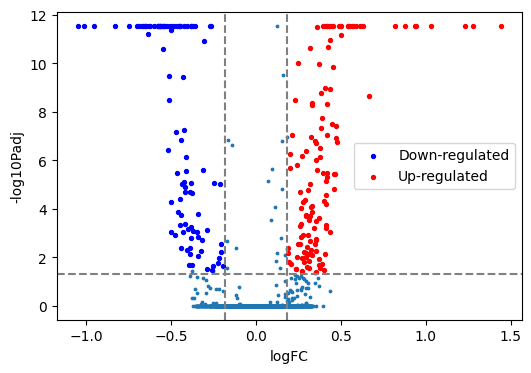

In [22]:
down = DE_avg[DE_avg['DE'] & (DE_avg['coef_avg']<0)]
up = DE_avg[DE_avg['DE'] & (DE_avg['coef_avg']>0)]
with plt.rc_context({'figure.figsize' : (6,4)}):
    plt.scatter(x=DE_avg['coef_avg'],y=-np.log10(DE_avg['padj_avg']),s=3)
    plt.scatter(x=down['coef_avg'],y=-np.log10(down['padj_avg']),s=8,label="Down-regulated",color="blue")
    plt.scatter(x=up['coef_avg'],y=-np.log10(up['padj_avg']),s=8,label="Up-regulated",color="red")
    
    plt.xlabel("logFC")
    plt.ylabel("-log10Padj")
    plt.axvline(np.log(1.2),color="grey",linestyle="--")
    plt.axvline(-np.log(1.2),color="grey",linestyle="--")
    plt.axhline(-np.log10(0.05),color="grey",linestyle="--")
    plt.legend()

In [30]:
pd.DataFrame(coefs_DEGs_sels.index[(coefs_DEGs_sels>0).sum(axis=1)>0]).to_csv('outputs/cortical_DEG_pos.txt', header=False, index=False)
str(list(coefs_DEGs_sels.index[(coefs_DEGs_sels>0).sum(axis=1)>0]))

"['SLC25A5', 'AKAP8L', 'STMN4', 'STRAP', 'KCNG1', 'LMO3', 'PITHD1', 'YBX1', 'PKM', 'PFN2', 'ENO1', 'CDH7', 'SMAP2', 'DNAJA1', 'PEBP1', 'MLF2', 'TSPO', 'PSMA7', 'EEF1A2', 'CELF4', 'VAPA', 'PGRMC1', 'SYP', 'PCSK1N', 'USP11', 'ASAH1', 'SLC17A7', 'OAZ1', 'BBC3', 'ATP1A3', 'RAB3A', 'TMEM59L', 'UBE2S', 'CPE', 'TPI1', 'ENO2', 'LDHB', 'COX6A1', 'SRSF9', 'FAM162A', 'IGFBP2', 'IGFBP5', 'ATP6V0B', 'TTR', 'A1BG', 'MORF4L2', 'THRA', 'YWHAH', 'NDUFA5', 'CDKN2D', 'NEDD8', 'LSM4', 'OLFM1', 'MAP1B', 'SNAP25', 'BEX2', 'DTNA', 'RAC1', 'MTCH1', 'FXYD6', 'TXNL4A', 'ARF1', 'GUK1', 'CALM2', 'ARL6IP5', 'SNCA', 'PNRC1', 'EI24', 'UBC', 'SLC25A4', 'MZT2B', 'FEZF2', 'UQCRB', 'SV2A', 'PTMS', 'CALM3', 'VSNL1', 'CAMKV', 'BRI3', 'TERF2IP', 'MAP1A', 'SPINT2', 'SRRM2', 'SLC3A2', 'RNF187', 'KIF5C', 'PRELID1', 'TRAPPC1', 'ARL6IP1', 'GAP43', 'CYCS', 'BSG', 'MZT2A', 'EIF1', 'TTC9B', 'AKIRIN1', 'SEZ6L2', 'CLTB', 'CCDC85B', 'BNIP3', 'ZFAS1', 'COX5A', 'FJX1', 'ATP6AP2', 'NDN', 'ACTG1', 'UQCR10', 'NDUFA12', 'KRT10', 'C11orf96'

In [31]:
pd.DataFrame(coefs_DEGs_sels.index[(coefs_DEGs_sels<0).sum(axis=1)>0]).to_csv('outputs/cortical_DEG_neg.txt', header=False, index=False)
str(list(coefs_DEGs_sels.index[(coefs_DEGs_sels<0).sum(axis=1)>0]))

"['NFIX', 'LRRC7', 'NNAT', 'LIMCH1', 'CTNNA2', 'SEMA3C', 'RBFOX1', 'RUNX1T1', 'MEF2C', 'NRP1', 'TTC28', 'EPHB6', 'CHCHD2', 'PPP1R17', 'RPL19', 'RPL34', 'MDK', 'RPS12', 'RBP1', 'RPL24', 'AKT3', 'STMN1', 'SATB2', 'RPL21', 'TUBA1B', 'RPS10', 'CHL1', 'MEIS2', 'SOX5', 'HNRNPA1', 'RPS6', 'SLC44A5', 'RPS24', 'RPS27A', 'AFF3', 'RPL32', 'EPHA5', 'RPS3A', 'RPL37', 'RPL10', 'TENM4', 'ADGRL3', 'SETBP1', 'PTPRK', 'PTPRD', 'SORBS2', 'EEF1A1', 'UNC5D', 'NRG1', 'LRP8', 'ADGRV1', 'FABP7', 'FABP5', 'SCG5', 'TUBA1A', 'POLR2J3', 'LDLRAD4', 'SLC25A6', 'MN1', 'ZEB2', 'FOS', 'RPS9', 'ENC1', 'MLLT3', 'C1QTNF4', 'MSRA', 'RPS27', 'ZBTB18', 'NRXN1', 'NTM', 'KCNB2', 'KCNH8', 'CCSER1', 'POU3F2', 'KCNH7', 'ROBO2', 'MYT1L', 'SHTN1', 'DCC', 'RPL14', 'TUBB', 'TCF4', 'RPS26', 'RPL23A', 'RPL10A', 'NHSL2', 'HSPA1A', 'FAM155A', 'DOK6', 'MEG3', 'MIR99AHG', 'XIST', 'LINC01122', 'LINC01102', 'AMY2B', 'AMY2A', 'MTRNR2L3', 'MTRNR2L6', 'CASC15', 'CD24']"

In [36]:
adata[:,DE_sels[0].index].var['ensembl'].to_csv('outputs/cortical_tested.txt', header=False, index=False)

In [25]:
np.intersect1d(robust_DEGs, ['COX8A','NDUFA7','NDUFA9','GPI','PGAM1','ALDOC','ENO1','ENO2','PFKP'])

array(['ENO1', 'ENO2'], dtype=object)

In [27]:
coefs_sels.loc[['COX8A','NDUFA7','NDUFA9','GPI','PGAM1','ALDOC','ENO1','ENO2','PFKP'],:]

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
COX8A,0.171195,0.170203,0.166449,0.170210,0.168348,0.171745,0.172444,0.167370,0.168700,0.169706,0.171543,0.169048,0.171598,0.171013,0.175837,0.173142,0.175952,0.172482,0.169998,0.174351
NDUFA7,0.138623,0.137949,0.138277,0.136912,0.138135,0.138758,0.139402,0.137218,0.136661,0.140705,0.135808,0.136857,0.138381,0.135321,0.138509,0.138426,0.136056,0.136234,0.136614,0.137729
NDUFA9,0.021763,0.024667,0.019153,0.026155,0.024136,0.024619,0.023622,0.020261,0.019173,0.023177,0.018601,0.024018,0.022324,0.021545,0.021216,0.023938,0.024477,0.018351,0.021606,0.021790
GPI,0.150072,0.149004,0.152420,0.149777,0.153983,0.149737,0.150558,0.151929,0.152712,0.153693,0.152104,0.149989,0.151826,0.150017,0.152153,0.153504,0.150851,0.154373,0.151661,0.153284
PGAM1,0.269211,0.269956,0.268185,0.274689,0.269883,0.269688,0.267907,0.269955,0.272556,0.264274,0.272872,0.268338,0.270284,0.274200,0.272055,0.270024,0.271744,0.271490,0.268594,0.268393
ALDOC,0.114010,0.114532,0.111170,0.112035,0.115031,0.111377,0.111800,0.114562,0.114994,0.111701,0.112202,0.112806,0.112477,0.114402,0.113120,0.110443,0.112230,0.112783,0.112326,0.113150
ENO1,0.408015,0.408756,0.406104,0.409209,0.408228,0.406528,0.409556,0.410289,0.408117,0.405377,0.410898,0.406776,0.411927,0.403852,0.408983,0.412795,0.403450,0.411018,0.407439,0.413740
ENO2,0.440694,0.435491,0.438613,0.438125,0.437821,0.439948,0.438369,0.437427,0.434748,0.437460,0.440891,0.432796,0.440510,0.443776,0.440932,0.440379,0.435475,0.432608,0.437181,0.441212
PFKP,0.102923,0.106556,0.102636,0.106934,0.105984,0.104143,0.104344,0.102994,0.105540,0.106275,0.104244,0.105548,0.107615,0.102460,0.104385,0.103821,0.105229,0.105944,0.105776,0.105666


In [29]:
p_sels.loc[['COX8A','NDUFA7','NDUFA9','GPI','PGAM1','ALDOC','ENO1','ENO2','PFKP'],:]

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
COX8A,2.340273e-01,2.379135e-01,2.604907e-01,2.415011e-01,2.497407e-01,2.310259e-01,2.251060e-01,2.547570e-01,2.472288e-01,2.434235e-01,2.311641e-01,2.453488e-01,2.313794e-01,2.335578e-01,2.083408e-01,2.250020e-01,2.081963e-01,2.252955e-01,2.398477e-01,2.168633e-01
NDUFA7,8.545416e-04,9.680487e-04,9.099111e-04,1.174451e-03,9.018763e-04,7.943212e-04,6.981036e-04,1.086780e-03,1.151262e-03,6.415438e-04,1.338553e-03,1.115580e-03,7.979138e-04,1.362727e-03,8.596174e-04,9.262611e-04,1.279474e-03,1.180732e-03,1.159724e-03,1.025863e-03
NDUFA9,9.571510e-01,9.440445e-01,9.670609e-01,9.375898e-01,9.469308e-01,9.450252e-01,9.491902e-01,9.628786e-01,9.668237e-01,9.514584e-01,9.688024e-01,9.475179e-01,9.546771e-01,9.578100e-01,9.593019e-01,9.479647e-01,9.454503e-01,9.695519e-01,9.575928e-01,9.570596e-01
GPI,4.238640e-02,4.521817e-02,3.672378e-02,4.490469e-02,3.222032e-02,4.362586e-02,4.100002e-02,3.844993e-02,3.618839e-02,3.429424e-02,3.788502e-02,4.343431e-02,3.853503e-02,4.194482e-02,3.715818e-02,3.405122e-02,4.122108e-02,3.196588e-02,3.906122e-02,3.481064e-02
PGAM1,9.485040e-05,8.751968e-05,1.092911e-04,5.148407e-05,9.229576e-05,8.902129e-05,1.103456e-04,8.966039e-05,6.480399e-05,1.809140e-04,6.508652e-05,1.030848e-04,8.844821e-05,5.004588e-05,6.387613e-05,9.176424e-05,7.343342e-05,7.203307e-05,9.857560e-05,1.020855e-04
ALDOC,2.478729e-02,2.358462e-02,3.349910e-02,2.995607e-02,2.327441e-02,3.133439e-02,3.060732e-02,2.319862e-02,2.241385e-02,3.099833e-02,2.996125e-02,2.699573e-02,2.989479e-02,2.312649e-02,2.698949e-02,3.386059e-02,2.839417e-02,2.839066e-02,2.970107e-02,2.715933e-02
ENO1,7.172041e-14,5.351275e-14,1.423306e-13,6.261658e-14,7.815970e-14,1.152411e-13,4.307665e-14,3.841372e-14,7.194245e-14,1.811884e-13,2.620126e-14,9.081624e-14,2.509104e-14,2.216005e-13,4.973799e-14,2.198242e-14,2.442491e-13,2.509104e-14,8.082424e-14,1.731948e-14
ENO2,2.220446e-16,2.220446e-16,2.220446e-16,2.220446e-16,2.220446e-16,2.220446e-16,2.220446e-16,2.220446e-16,2.220446e-16,2.220446e-16,2.220446e-16,2.220446e-16,2.220446e-16,2.220446e-16,2.220446e-16,2.220446e-16,2.220446e-16,2.220446e-16,2.220446e-16,2.220446e-16
PFKP,1.418540e-01,1.129450e-01,1.434273e-01,1.128916e-01,1.204901e-01,1.329612e-01,1.280713e-01,1.409407e-01,1.182168e-01,1.189105e-01,1.298986e-01,1.194268e-01,1.079068e-01,1.437947e-01,1.312349e-01,1.337065e-01,1.202272e-01,1.165039e-01,1.179111e-01,1.193479e-01


## DE analysis without covariates as comparison, using all samples with cell number per dataset balanced

In [6]:
adata_joint2 = sc.read_h5ad('../../data/phase3_final_0516/cortical_neuron_HNOCA_refs_filtered.h5ad')

In [7]:
df_sel_all = pd.read_csv('DE_cortical_cell_subset_selection.tsv', sep='\t', index_col=0, header=0)
df_sel_all.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
homosapiens_None_2020_10x3v2_bhaduriaparna_001_d10_1038_s41586_020_1962_0_181158,False,False,False,True,False,True,False,True,True,True,True,False,False,True,True,True,False,True,False,True
homosapiens_None_2020_10x3v2_bhaduriaparna_001_d10_1038_s41586_020_1962_0_195699,False,True,True,False,True,False,False,True,False,True,False,True,True,False,False,True,False,False,False,False
homosapiens_None_2020_10x3v2_bhaduriaparna_001_d10_1038_s41586_020_1962_0_120,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True
homosapiens_None_2020_10x3v2_bhaduriaparna_001_d10_1038_s41586_020_1962_0_1841,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True
homosapiens_None_2020_10x3v2_bhaduriaparna_001_d10_1038_s41586_020_1962_0_2793,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True


In [ ]:
DE_sels_nocov = Parallel(n_jobs=10)(
    delayed(ancova_group_test)(adata_joint2[df_sel_all.iloc[:,i],:].X,
                               adata_joint2.obs['datatype'][df_sel_all.iloc[:,i]],
                               None,
                               1,
                               'organoid',
                               adata_joint2.var_names) for i in range(df_sel_all.shape[1])
)

In [10]:
DE_sels_nocov[0]

,var_group,var_covar,var_total,p_ANCOVA,p_Resi,coef
TSPAN6,71.573266,0.0,29295.434873,1.607776e-145,5.259025e-01,0.032607
DPM1,440.201059,0.0,74144.294338,0.000000e+00,1.222433e-01,0.080865
SCYL3,40.761782,0.0,15993.479431,1.004788e-151,5.081393e-01,-0.024607
C1orf112,38.344762,0.0,10695.288988,1.057361e-212,3.514676e-01,-0.023866
FUCA2,0.734311,0.0,13579.533252,1.338186e-04,9.895637e-01,-0.003303
...,...,...,...,...,...,...
TBCE,803.518890,0.0,19344.999508,0.000000e+00,2.220446e-16,-0.109253
ARHGAP11B,0.093219,0.0,3107.522475,4.445774e-03,9.945524e-01,-0.001177
CDR1,0.002053,0.0,10087.299989,8.147637e-01,9.992740e-01,0.000175
PRRC2B,4114.707338,0.0,159410.621631,0.000000e+00,1.120903e-11,-0.247231


In [12]:
import pickle
with open('DE_cortical_sel_nocov.pickle', 'wb') as f:
    pickle.dump(DE_sels_nocov, f)

In [16]:
import pickle
with open('DE_cortical_sel_nocov.pickle', 'rb') as f:
    DE_sels_nocov = pickle.load(f)

In [17]:
from statsmodels.stats.multitest import multipletests
DE_sels_nocov = [ pd.concat([x, pd.DataFrame({'padj':multipletests(x['p_Resi'], method='holm')[1]},index=x.index)], axis=1) for x in DE_sels_nocov ]
DE_sels_nocov[0]

,var_group,var_covar,var_total,p_ANCOVA,p_Resi,coef,padj
TSPAN6,71.573266,0.0,29295.434873,1.607776e-145,5.259025e-01,0.032607,1.000000e+00
DPM1,440.201059,0.0,74144.294338,0.000000e+00,1.222433e-01,0.080865,1.000000e+00
SCYL3,40.761782,0.0,15993.479431,1.004788e-151,5.081393e-01,-0.024607,1.000000e+00
C1orf112,38.344762,0.0,10695.288988,1.057361e-212,3.514676e-01,-0.023866,1.000000e+00
FUCA2,0.734311,0.0,13579.533252,1.338186e-04,9.895637e-01,-0.003303,1.000000e+00
...,...,...,...,...,...,...,...
TBCE,803.518890,0.0,19344.999508,0.000000e+00,2.220446e-16,-0.109253,2.884804e-12
ARHGAP11B,0.093219,0.0,3107.522475,4.445774e-03,9.945524e-01,-0.001177,1.000000e+00
CDR1,0.002053,0.0,10087.299989,8.147637e-01,9.992740e-01,0.000175,1.000000e+00
PRRC2B,4114.707338,0.0,159410.621631,0.000000e+00,1.120903e-11,-0.247231,1.258438e-07


In [18]:
is_DE_nocov = pd.DataFrame(np.transpose(np.array([ ((x['padj']<0.05) & (np.abs(x['coef'])>np.log(1.2))) for x in DE_sels_nocov])), index=DE_sels_nocov[0].index)
is_DE_nocov.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
TSPAN6,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
DPM1,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
SCYL3,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
C1orf112,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
FUCA2,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False


In [19]:
coefs_sels_nocov = pd.DataFrame(np.transpose(np.array([x['coef'] for x in DE_sels_nocov])), index=DE_sels_nocov[0].index)
p_sels_nocov = pd.DataFrame(np.transpose(np.array([x['p_Resi'] for x in DE_sels_nocov])), index=DE_sels_nocov[0].index)
padj_sels_nocov = pd.DataFrame(np.transpose(np.array([x['padj'] for x in DE_sels_nocov])), index=DE_sels_nocov[0].index)
DE_nocov_avg = pd.DataFrame({'pval_avg' : p_sels_nocov.mean(axis=1),
                             'padj_avg' : padj_sels_nocov.mean(axis=1),
                             'coef_avg' : coefs_sels_nocov.mean(axis=1),
                             'DE' : is_DE_nocov.mean(axis=1)>0.8})
DE_nocov_avg

,pval_avg,padj_avg,coef_avg,DE
TSPAN6,5.259699e-01,1.000000e+00,0.032549,False
DPM1,1.237195e-01,1.000000e+00,0.080684,False
SCYL3,5.391913e-01,1.000000e+00,-0.023620,False
C1orf112,3.181732e-01,1.000000e+00,-0.024616,False
FUCA2,9.925355e-01,1.000000e+00,-0.002761,False
...,...,...,...,...
TBCE,2.220446e-16,2.884804e-12,-0.108948,False
ARHGAP11B,9.981797e-01,1.000000e+00,-0.000682,False
CDR1,9.990068e-01,1.000000e+00,0.000815,False
PRRC2B,1.869295e-11,2.091574e-07,-0.246565,True


In [20]:
DE_nocov_avg.to_csv('outputs/cortical_DE_woCov_avg.tsv', sep='\t')

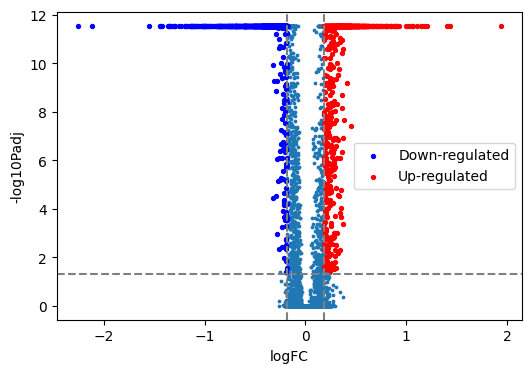

In [27]:
down = DE_nocov_avg[DE_nocov_avg['DE'] & (DE_nocov_avg['coef_avg']<0)]
up = DE_nocov_avg[DE_nocov_avg['DE'] & (DE_nocov_avg['coef_avg']>0)]
with plt.rc_context({'figure.figsize' : (6,4)}):
    plt.scatter(x=DE_nocov_avg['coef_avg'],y=-np.log10(DE_nocov_avg['padj_avg']),s=3)
    plt.scatter(x=down['coef_avg'],y=-np.log10(down['padj_avg']),s=8,label="Down-regulated",color="blue")
    plt.scatter(x=up['coef_avg'],y=-np.log10(up['padj_avg']),s=8,label="Up-regulated",color="red")
    
    plt.xlabel("logFC")
    plt.ylabel("-log10Padj")
    plt.axvline(np.log(1.2),color="grey",linestyle="--")
    plt.axvline(-np.log(1.2),color="grey",linestyle="--")
    plt.axhline(-np.log10(0.05),color="grey",linestyle="--")
    plt.legend()

In [14]:
robust_DEGs_nocov = is_DE_nocov.index[is_DE_nocov.mean(axis=1)>0.8]
coefs_DEGs_sels_nocov = pd.DataFrame(np.transpose(np.array([x.loc[robust_DEGs_nocov,'coef'] for x in DE_sels_nocov])), index=robust_DEGs_nocov)

In [27]:
(coefs_DEGs_sels_nocov > 0).sum(axis=1).value_counts()

0     896
20    735
dtype: int64

In [29]:
pd.DataFrame(coefs_DEGs_sels_nocov.index[(coefs_DEGs_sels_nocov>0).sum(axis=1)>0]).to_csv('outputs/cortical_DEG_pos_nocov.txt', header=False, index=False)
pd.DataFrame(coefs_DEGs_sels_nocov.index[(coefs_DEGs_sels_nocov<0).sum(axis=1)>0]).to_csv('outputs/cortical_DEG_neg_nocov.txt', header=False, index=False)

### Compare with DEG enriched functions with those with covariates

In [21]:
david_pos_cov = pd.read_csv('outputs/DAVID_chart_cortical_DEG_pos2.tsv', sep='\t', header=0, index_col=[1])
david_neg_cov = pd.read_csv('outputs/DAVID_chart_cortical_DEG_neg.tsv', sep='\t', header=0, index_col=[1])

In [22]:
david_pos_nocov = pd.read_csv('outputs/DAVID_chart_cortical_DEG_pos_nocov2.tsv', sep='\t', header=0, index_col=[1])
david_neg_nocov = pd.read_csv('outputs/DAVID_chart_cortical_DEG_neg_nocov.tsv', sep='\t', header=0, index_col=[1])

In [35]:
david_pos_cov.head()

,Category,Count,%,PValue,Genes,List Total,Pop Hits,Pop Total,Fold Enrichment,Bonferroni,Benjamini,FDR
Term,,,,,,,,,,,,
hsa05012:Parkinson disease,KEGG_PATHWAY,18,14.876033,3.656826e-10,"UQCRB, NDUFA5, NDUFA4, NDUFA12, UQCR10, COX6A1...",66,222,5498,6.754300,6.326309e-08,6.326309e-08,5.704648e-08
hsa05022:Pathways of neurodegeneration - multiple diseases,KEGG_PATHWAY,19,15.702479,2.902647e-07,"UQCRB, NDUFA5, NDUFA4, NDUFA12, UQCR10, COX6A1...",66,388,5498,4.079272,5.021455e-05,2.324668e-05,2.096232e-05
hsa05010:Alzheimer disease,KEGG_PATHWAY,17,14.049587,4.031216e-07,"UQCRB, NDUFA5, NDUFA4, NDUFA12, UQCR10, COX6A1...",66,312,5498,4.538947,6.973762e-05,2.324668e-05,2.096232e-05
hsa05020:Prion disease,KEGG_PATHWAY,14,11.570248,9.946835e-07,"UQCRB, NDUFA5, NDUFA4, NDUFA12, UQCR10, COX6A1...",66,216,5498,5.399270,1.720655e-04,4.302006e-05,3.879265e-05
hsa05016:Huntington disease,KEGG_PATHWAY,15,12.396694,1.374965e-06,"UQCRB, NDUFA5, NDUFA4, NDUFA12, CLTB, UQCR10, ...",66,260,5498,4.805944,2.378409e-04,4.757380e-05,4.289892e-05


In [23]:
enrich_pos = pd.concat([ david_pos_cov[['PValue','Fold Enrichment','Benjamini']].set_axis(['PValue_cov','FoldEnrichment_cov','Benjamini_cov'], axis=1),
                        david_pos_nocov[['PValue','Fold Enrichment','Benjamini']].set_axis(['PValue_nocov','FoldEnrichment_nocov','Benjamini_nocov'], axis=1)], axis=1).loc[lambda x: (~np.isnan(x['PValue_cov'])) & (~np.isnan(x['PValue_nocov'])) ,:]
enrich_pos

,PValue_cov,FoldEnrichment_cov,Benjamini_cov,PValue_nocov,FoldEnrichment_nocov,Benjamini_nocov
Term,,,,,,
hsa05012:Parkinson disease,3.656826e-10,6.754300,6.326309e-08,1.075570e-42,5.161951,3.086887e-40
hsa05022:Pathways of neurodegeneration - multiple diseases,2.902647e-07,4.079272,2.324668e-05,2.575730e-25,3.119414,1.232057e-23
hsa05010:Alzheimer disease,4.031216e-07,4.538947,2.324668e-05,2.015172e-24,3.384045,8.262206e-23
hsa05020:Prion disease,9.946835e-07,5.399270,4.302006e-05,2.552986e-34,4.709233,3.663535e-32
hsa05016:Huntington disease,1.374965e-06,4.805944,4.757380e-05,3.193628e-31,4.110377,3.055237e-29
...,...,...,...,...,...,...
hsa01200:Carbon metabolism,8.982163e-02,3.702357,3.946214e-01,3.499224e-03,2.289045,3.347591e-02
hsa05110:Vibrio cholerae infection,9.124195e-02,5.811839,3.946214e-01,1.282216e-05,4.192146,1.839979e-04
GO:0061795~Golgi lumen acidification,9.223453e-02,20.587273,1.000000e+00,1.882963e-02,6.650808,5.909439e-01


In [24]:
enrich_pos.to_csv('outputs/DAVID_comparison_cortical_DEG_pos2.tsv', sep='\t')

In [68]:
enrich_pos.loc[[x for x in enrich_pos.index if re.search('[gG]lycolysis',x) is not None ],:]

,PValue_cov,FoldEnrichment_cov,Benjamini_cov,PValue_nocov,FoldEnrichment_nocov,Benjamini_nocov
Term,,,,,,
GO:0061621~canonical glycolysis,0.000535,24.220321,0.070492,0.000321,6.846420,0.025447
hsa00010:Glycolysis / Gluconeogenesis,0.001422,9.917027,0.020497,0.000052,3.985391,0.000709
KW-0324~Glycolysis,0.002250,14.863521,0.034234,0.000001,7.155520,0.000025


In [69]:
enrich_pos.loc[[x for x in enrich_pos.index if re.search('[mM]itochondrial',x) is not None ],:]

,PValue_cov,FoldEnrichment_cov,Benjamini_cov,PValue_nocov,FoldEnrichment_nocov,Benjamini_nocov
Term,,,,,,
"GO:0006123~mitochondrial electron transport, cytochrome c to oxygen",0.000637,22.874747,0.072259,2.663236e-11,12.008403,7.986748e-09
TOPO_DOM:Mitochondrial intermembrane,0.000991,6.071459,0.270038,3.071015e-07,3.459290,2.539730e-04
GO:0005743~mitochondrial inner membrane,0.005429,2.812903,0.096628,1.734552e-18,3.109189,1.580920e-16
GO:0010917~negative regulation of mitochondrial membrane potential,0.005690,25.734091,0.215053,4.328633e-03,6.927925,2.163515e-01
"GO:0006122~mitochondrial electron transport, ubiquinol to cytochrome c",0.006683,23.754545,0.233135,1.597580e-07,11.511013,3.079906e-05
GO:0005741~mitochondrial outer membrane,0.006804,4.125297,0.106857,1.475826e-03,2.130263,1.776560e-02
TOPO_DOM:Mitochondrial matrix,0.007394,6.426760,1.000000,6.159974e-07,4.058414,3.730833e-04
GO:0031966~mitochondrial membrane,0.008506,4.732759,0.126178,1.780800e-09,3.758499,5.680753e-08
GO:0005751~mitochondrial respiratory chain complex IV,0.014232,16.191016,0.165217,1.949527e-12,12.414641,1.036499e-10


In [70]:
enrich_pos.loc[[x for x in enrich_pos.index if re.search('electron transport',x) is not None ],:]

,PValue_cov,FoldEnrichment_cov,Benjamini_cov,PValue_nocov,FoldEnrichment_nocov,Benjamini_nocov
Term,,,,,,
"GO:0006123~mitochondrial electron transport, cytochrome c to oxygen",0.000637,22.874747,0.072259,2.663236e-11,12.008403,7.986748e-09
"GO:0006122~mitochondrial electron transport, ubiquinol to cytochrome c",0.006683,23.754545,0.233135,1.597580e-07,11.511013,3.079906e-05


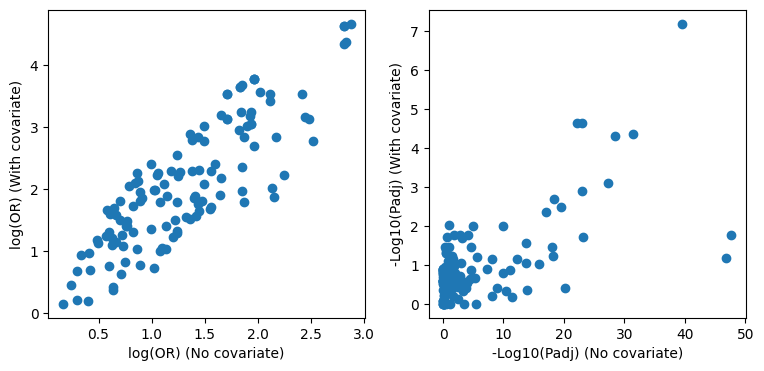

In [71]:
fig, ax = plt.subplots(1,2,figsize=(9,4))
ax[0].scatter(np.log(enrich_pos['FoldEnrichment_nocov']),
                 np.log(enrich_pos['FoldEnrichment_cov']))
ax[0].set_xlabel('log(OR) (No covariate)')
ax[0].set_ylabel('log(OR) (With covariate)')
ax[1].scatter(-np.log10(enrich_pos['Benjamini_nocov']),
                 -np.log10(enrich_pos['Benjamini_cov']))
ax[1].set_xlabel('-Log10(Padj) (No covariate)')
ax[1].set_ylabel('-Log10(Padj) (With covariate)')
plt.show()

In [72]:
enrich_pos.loc[(enrich_pos['Benjamini_cov']>0.01) & (enrich_pos['Benjamini_nocov']<1e-20),:]

,PValue_cov,FoldEnrichment_cov,Benjamini_cov,PValue_nocov,FoldEnrichment_nocov,Benjamini_nocov
Term,,,,,,
GO:0070062~extracellular exosome,0.000242,2.079078,0.017185,3.332820e-51,2.769440,2.126339e-48
KW-0679~Respiratory chain,0.000417,9.261117,0.019592,7.655358e-26,9.457296,7.655358e-24
KW-0007~Acetylation,0.003097,1.448578,0.065028,5.778881e-49,1.894844,1.618087e-47
GO:0005829~cytosol,0.054045,1.226765,0.395666,2.795533e-23,1.493951,5.945166e-21


In [73]:
enrich_pos.loc[(enrich_pos['Benjamini_cov']>0.1) & (enrich_pos['Benjamini_nocov']<1e-10),:]

,PValue_cov,FoldEnrichment_cov,Benjamini_cov,PValue_nocov,FoldEnrichment_nocov,Benjamini_nocov
Term,,,,,,
KW-0945~Host-virus interaction,0.017455,2.192979,0.136076,2.147721e-13,2.431384,7.159071e-12
GO:0005829~cytosol,0.054045,1.226765,0.395666,2.795533e-23,1.493951,5.945166e-21
GO:0008137~NADH dehydrogenase (ubiquinone) activity,0.058476,7.575325,0.679520,2.900578e-14,8.478198,4.443685e-12
GO:0005747~mitochondrial respiratory chain complex I,0.075615,6.545304,0.448651,1.647678e-16,8.603460,1.314023e-14
GO:0005739~mitochondrion,0.082498,1.527811,0.467952,7.177549e-13,1.890097,4.579276e-11


In [76]:
enrich_pos.loc[(enrich_pos['Benjamini_cov']<0.1) & (enrich_pos['Benjamini_nocov']>enrich_pos['Benjamini_cov']),:]

,PValue_cov,FoldEnrichment_cov,Benjamini_cov,PValue_nocov,FoldEnrichment_nocov,Benjamini_nocov
Term,,,,,,
GO:0043065~positive regulation of apoptotic process,0.000065,4.988106,0.019588,0.004929,1.831170,0.233403
GO:1901842~negative regulation of high voltage-gated calcium channel activity,0.000274,102.936364,0.049657,0.010373,16.627019,0.370382
GO:0051343~positive regulation of cyclic-nucleotide phosphodiesterase activity,0.000274,102.936364,0.049657,0.010373,16.627019,0.370382
GO:0005615~extracellular space,0.000563,2.653322,0.017185,0.001414,1.513026,0.017354
hsa04721:Synaptic vesicle cycle,0.000605,8.471495,0.009513,0.014120,2.400587,0.108136
GO:0030017~sarcomere,0.001536,17.090517,0.034187,0.011950,4.212110,0.100317
KW-0341~Growth regulation,0.001628,9.646997,0.034234,0.072731,2.364324,0.484873
hsa04971:Gastric acid secretion,0.003375,7.858776,0.041709,0.049447,2.186470,0.289946
hsa05416:Viral myocarditis,0.008527,9.255892,0.077645,0.018619,2.861306,0.130331


In [25]:
enrich_neg = pd.concat([ david_neg_cov[['PValue','Fold Enrichment','Benjamini']].set_axis(['PValue_cov','FoldEnrichment_cov','Benjamini_cov'], axis=1),
                        david_neg_nocov[['PValue','Fold Enrichment','Benjamini']].set_axis(['PValue_nocov','FoldEnrichment_nocov','Benjamini_nocov'], axis=1)], axis=1).loc[lambda x: (~np.isnan(x['PValue_cov'])) & (~np.isnan(x['PValue_nocov'])) ,:]
enrich_neg

,PValue_cov,FoldEnrichment_cov,Benjamini_cov,PValue_nocov,FoldEnrichment_nocov,Benjamini_nocov
Term,,,,,,
IPR013098:Ig_I-set,3.316658e-07,13.252688,0.000118,1.230844e-17,5.573560,1.256076e-14
KW-0217~Developmental protein,4.506474e-07,3.624492,0.000004,4.258039e-04,1.539377,2.825789e-03
KW-9996~Developmental protein,4.506474e-07,3.624492,0.000004,4.258039e-04,1.539377,2.825789e-03
GO:0007411~axon guidance,2.504964e-06,8.407336,0.000615,9.625816e-18,4.377252,3.113951e-14
KW-0221~Differentiation,4.107103e-06,4.623737,0.000119,8.482327e-04,1.594662,1.492890e-02
...,...,...,...,...,...,...
GO:0005005~transmembrane-ephrin receptor activity,9.277245e-02,20.395105,0.836184,1.232368e-03,6.696900,4.128348e-02
IPR013320:ConA-like_dom_sf,9.442770e-02,3.651852,0.856732,6.556059e-04,2.207749,2.432894e-02
KW-0631~Potassium channel,9.603203e-02,5.656553,0.420140,3.871711e-03,2.890417,1.898684e-02


In [26]:
enrich_neg.to_csv('outputs/DAVID_comparison_cortical_DEG_neg.tsv', sep='\t')

In [61]:
enrich_neg.loc[[x for x in enrich_neg.index if re.search(r'adhesion',x) is not None ],:]

,PValue_cov,FoldEnrichment_cov,Benjamini_cov,PValue_nocov,FoldEnrichment_nocov,Benjamini_nocov
Term,,,,,,
GO:0098609~cell-cell adhesion,0.003041,6.020737,0.248646,4.367973e-07,3.066532,0.000202
GO:0007157~heterophilic cell-cell adhesion via plasma membrane cell adhesion molecules,0.020654,13.331633,0.894205,1.494254e-06,6.035714,0.000345
GO:0050839~cell adhesion molecule binding,0.032491,10.465909,0.545852,1.815752e-04,4.200249,0.011691
GO:0007155~cell adhesion,0.041348,2.730408,1.000000,1.959291e-07,2.207419,0.000127


In [57]:
enrich_neg.loc[[x for x in enrich_neg.index if re.search(r'[Ss]ynapse',x) is not None ],:]

,PValue_cov,FoldEnrichment_cov,Benjamini_cov,PValue_nocov,FoldEnrichment_nocov,Benjamini_nocov
Term,,,,,,
GO:0045202~synapse,0.000172,4.005051,0.003127,2.391129e-07,2.067825,0.000011
GO:0099054~presynapse assembly,0.091362,20.738095,1.000000,7.842437e-03,5.868056,0.302027


In [60]:
enrich_neg.loc[[x for x in enrich_neg.index if re.search(r'[nN]ervous',x) is not None ],:]

,PValue_cov,FoldEnrichment_cov,Benjamini_cov,PValue_nocov,FoldEnrichment_nocov,Benjamini_nocov
Term,,,,,,
GO:0007399~nervous system development,0.00002,4.621633,0.003629,3.717271e-13,2.655714,6.012687e-10


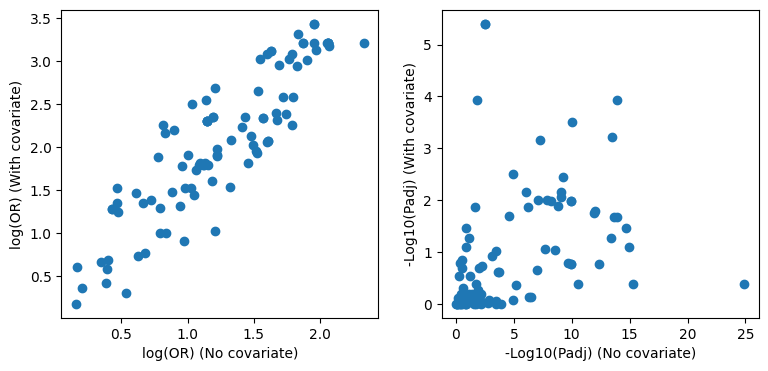

In [32]:
fig, ax = plt.subplots(1,2,figsize=(9,4))
ax[0].scatter(np.log(enrich_neg['FoldEnrichment_nocov']),
                 np.log(enrich_neg['FoldEnrichment_cov']))
ax[0].set_xlabel('log(OR) (No covariate)')
ax[0].set_ylabel('log(OR) (With covariate)')
ax[1].scatter(-np.log10(enrich_neg['Benjamini_nocov']),
                 -np.log10(enrich_neg['Benjamini_cov']))
ax[1].set_xlabel('-Log10(Padj) (No covariate)')
ax[1].set_ylabel('-Log10(Padj) (With covariate)')
plt.show()

In [80]:
enrich_neg.loc[(enrich_neg['Benjamini_cov']>0.01) & (enrich_neg['Benjamini_nocov']<1e-10),:]

,PValue_cov,FoldEnrichment_cov,Benjamini_cov,PValue_nocov,FoldEnrichment_nocov,Benjamini_nocov
Term,,,,,,
IPR013783:Ig-like_fold,0.000228,4.255336,0.016178,1.998826e-15,2.847134,1.019901e-12
DOMAIN:Fibronectin type-III,0.000239,7.905469,0.035085,2.215467e-18,4.960659,2.048753e-15
IPR003598:Ig_sub2,0.000294,7.608025,0.017421,2.821826e-15,4.456637,1.151869e-12
IPR003961:FN3_dom,0.000444,7.048611,0.021275,3.075728e-17,4.552424,2.092520e-14
IPR036116:FN3_sf,0.000479,6.946457,0.021275,8.862070e-18,4.590783,1.256076e-14
REGION:Disordered,0.000817,1.200184,0.080050,8.343975e-19,1.166680,1.028812e-15
TOPO_DOM:Extracellular,0.003083,2.087124,0.169580,5.549883e-16,1.872590,4.105804e-13
KW-0991~Intellectual disability,0.004939,2.160766,0.054325,5.742824e-16,1.965235,3.847692e-14
GO:0005886~plasma membrane,0.058086,1.358679,0.417766,2.143028e-28,1.700895,1.234384e-25


In [83]:
enrich_neg.loc[(enrich_neg['Benjamini_cov']<0.05) & (enrich_neg['Benjamini_nocov']>enrich_neg['Benjamini_cov']),:]

,PValue_cov,FoldEnrichment_cov,Benjamini_cov,PValue_nocov,FoldEnrichment_nocov,Benjamini_nocov
Term,,,,,,
KW-0217~Developmental protein,4.506474e-07,3.624492,0.000004,0.000426,1.539377,0.002826
KW-9996~Developmental protein,4.506474e-07,3.624492,0.000004,0.000426,1.539377,0.002826
KW-0221~Differentiation,4.107103e-06,4.623737,0.000119,0.000848,1.594662,0.014929
GO:0048666~neuron development,3.316622e-04,14.812925,0.034872,0.002308,3.353175,0.124465
KW-0732~Signal,1.663557e-03,1.842857,0.013308,0.007930,1.174507,0.022027


## Get coefficients for each dataset in relative to the primary, at least for the DEGs

In [7]:
adata_joint2 = sc.read_h5ad('../../data/phase3_final_0516/cortical_neuron_HNOCA_refs_filtered.h5ad')

In [8]:
df_sel_all = pd.read_csv('DE_cortical_cell_subset_selection.tsv', sep='\t', index_col=0, header=0)
df_sel_all.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
homosapiens_None_2020_10x3v2_bhaduriaparna_001_d10_1038_s41586_020_1962_0_181158,False,False,False,True,False,True,False,True,True,True,True,False,False,True,True,True,False,True,False,True
homosapiens_None_2020_10x3v2_bhaduriaparna_001_d10_1038_s41586_020_1962_0_195699,False,True,True,False,True,False,False,True,False,True,False,True,True,False,False,True,False,False,False,False
homosapiens_None_2020_10x3v2_bhaduriaparna_001_d10_1038_s41586_020_1962_0_120,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True
homosapiens_None_2020_10x3v2_bhaduriaparna_001_d10_1038_s41586_020_1962_0_1841,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True
homosapiens_None_2020_10x3v2_bhaduriaparna_001_d10_1038_s41586_020_1962_0_2793,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True


### Functions to get the coefficients

In [25]:
from scipy.sparse import issparse
from statsmodels.formula.api import ols
from tqdm import tqdm

def get_coefs(e, group, covar=None, var=None):
    if issparse(e):
        e = e.todense()
    e = np.array(e).flatten()
    
    if covar is None:
        m0 = ols('e ~ 1', data=pd.DataFrame({'e': e})).fit()
        m1 = ols('e ~ zz_group', data=pd.DataFrame({'e': e, 'zz_group': group})).fit()
    else:
        data = pd.DataFrame({'e': e, **covar, 'zz_group': group})
        m0 = ols('e ~ '+" + ".join(covar.columns), data=data).fit()
        m1 = ols('e ~ '+" + ".join(covar.columns)+' + zz_group', data=data).fit()
    
    coef_g = pd.DataFrame(dict(zip([x for x in m1.params.keys() if x.startswith('zz_group') ],
                                   [ m1.params[x] for x in m1.params.keys() if x.startswith('zz_group') ])),
                          index = [0] if var is None else [var])
    
    return coef_g

def get_coefs_for_all(expr, group, covar=None, control_grp = None, var_names=None):
    if not isinstance(group, pd.Series):
        group = pd.Series(group)
    idx = np.where(~group.isnull())[0]
    expr = expr[idx,:]
    group = group[idx]
    if covar is not None:
        covar = pd.DataFrame(covar).iloc[idx,:]
    
    if group.dtype.name != 'category':
        group = group.astype('category')
    group = group.cat.remove_unused_categories()
    g_lev = np.array(pd.Series(group).astype('category').cat.categories)
    if control_grp is not None and control_grp in g_lev:
        g_lev = np.concatenate([ [control_grp], g_lev[g_lev != control_grp] ])
        group = group.cat.reorder_categories(g_lev)
    
    results = list()
    for i in tqdm(range(expr.shape[1])):
        results.append(get_coefs(expr[:,i], group, covar=covar, var=var_names[i]))
    
    df_res = pd.concat(results)
    if var_names is not None and len(var_names) == df_res.shape[0]:
        df_res.index = var_names
    else:
        df_res.index = pd.RangeIndex(start=0, stop=expr.shape[1], step=1)
    return df_res

### Test the functions

In [9]:
adata_joint2.obs.columns

Index(['datatype', 'dataset', 'individual', 'sample', 'stage', 'age',
       'protocol', 'publication', 'sc_method', 'cluster1', 'cluster2',
       'cluster3', 'cluster4', 'cluster5', 'cluster6', 'Hallmark_Glycolysis',
       'bin_Glycolysis'],
      dtype='object')

In [10]:
e = np.array(adata_joint2[:,'MAP2'].X.todense()).flatten()
g = adata_joint2.obs['dataset'].astype('str')
g[adata_joint2.obs['datatype']=='primary'] = 'primary'
g.value_counts()

primary                                                                         333786
Paulsen, 2022: Velasco, 2019 (doi: 10.1038/s41586-019-1289-x)                   135806
Uzquiano, 2022: Velasco, 2019 (doi: 10.1038/s41586-019-1289-x)                  100287
Velasco, 2019: Velasco, 2019 (doi: 10.1038/s41586-019-1289-x)                    78826
Bowles, 2021: Yoon, 2019 (doi: 10.1038/s41592-018-0255-0)                        67074
Bhaduri, 2020: Velasco, 2019 (doi: 10.1038/s41586-019-1289-x)                    23598
Uzquiano, 2022: Quadrato, 2017 (doi: 10.1038/protex.2017.049)                    21744
Kanton, 2019: Lancaster, 2014 (doi: 10.1038/nprot.2014.158)                      21328
Bhaduri, 2020: Bhaduri, 2020 (doi: 10.1038/s41586-020-1962-0); directed          16178
Samarasinghe, 2021: Watanabe, 2017 (doi: 10.1016/j.celrep.2017.09.047)           13214
Yoon, 2019: Yoon, 2019 (doi: 10.1038/s41592-018-0255-0)                           7091
Trujillo, 2019: Trujillo, 2019 (doi: 10.101

In [11]:
covar = adata_joint2.obs.loc[:,['cluster5','bin_Glycolysis']]

In [13]:
g = g.astype('category')
g = g.cat.remove_unused_categories()
g_lev = np.array(pd.Series(g).astype('category').cat.categories)
g_lev = np.concatenate([ ['primary'], g_lev[g_lev != 'primary'] ])
g = g.cat.reorder_categories(g_lev)
g.cat.categories

Index(['primary',
       'Bhaduri, 2020: Bhaduri, 2020 (doi: 10.1038/s41586-020-1962-0); directed',
       'Bhaduri, 2020: Bhaduri, 2020 (doi: 10.1038/s41586-020-1962-0); most directed',
       'Bhaduri, 2020: Velasco, 2019 (doi: 10.1038/s41586-019-1289-x)',
       'Birey, 2017: Pasca, 2015 (doi: 10.1038/nmeth.3415)',
       'Bowles, 2021: Yoon, 2019 (doi: 10.1038/s41592-018-0255-0)',
       'Fleck, 2022: Lancaster, 2014 (doi: 10.1038/nprot.2014.158)',
       'He, 2022: Lancaster, 2014 (doi: 10.1038/nprot.2014.158)',
       'Kanton, 2019: Lancaster, 2014 (doi: 10.1038/nprot.2014.158)',
       'Khan, 2020: Pasca, 2015 (doi: 10.1038/nmeth.3415)',
       'Miura, 2020: Miura, 2020 (doi: 10.1038/s41587-020-00763-w)',
       'Paulsen, 2022: Velasco, 2019 (doi: 10.1038/s41586-019-1289-x)',
       'Pellegrini, 2020: Pellegrini, 2020 (doi: 10.1126/science.aaz5626); hCO',
       'Qian, 2020: Qian, 2020 (doi: 10.1016/j.stem.2020.02.002)',
       'Samarasinghe, 2021: Watanabe, 2017 (doi: 10.1016/j

In [23]:
get_coefs(e, g, covar, 'MAP2')

,"zz_group[T.Bhaduri, 2020: Bhaduri, 2020 (doi: 10.1038/s41586-020-1962-0); directed]","zz_group[T.Bhaduri, 2020: Bhaduri, 2020 (doi: 10.1038/s41586-020-1962-0); most directed]","zz_group[T.Bhaduri, 2020: Velasco, 2019 (doi: 10.1038/s41586-019-1289-x)]","zz_group[T.Birey, 2017: Pasca, 2015 (doi: 10.1038/nmeth.3415)]","zz_group[T.Bowles, 2021: Yoon, 2019 (doi: 10.1038/s41592-018-0255-0)]","zz_group[T.Fleck, 2022: Lancaster, 2014 (doi: 10.1038/nprot.2014.158)]","zz_group[T.He, 2022: Lancaster, 2014 (doi: 10.1038/nprot.2014.158)]","zz_group[T.Kanton, 2019: Lancaster, 2014 (doi: 10.1038/nprot.2014.158)]","zz_group[T.Khan, 2020: Pasca, 2015 (doi: 10.1038/nmeth.3415)]","zz_group[T.Miura, 2020: Miura, 2020 (doi: 10.1038/s41587-020-00763-w)]","zz_group[T.Paulsen, 2022: Velasco, 2019 (doi: 10.1038/s41586-019-1289-x)]","zz_group[T.Pellegrini, 2020: Pellegrini, 2020 (doi: 10.1126/science.aaz5626); hCO]","zz_group[T.Qian, 2020: Qian, 2020 (doi: 10.1016/j.stem.2020.02.002)]","zz_group[T.Samarasinghe, 2021: Watanabe, 2017 (doi: 10.1016/j.celrep.2017.09.047)]","zz_group[T.Trujillo, 2019: Trujillo, 2019 (doi: 10.1016/j.stem.2019.08.002)]","zz_group[T.Uzquiano, 2022: Quadrato, 2017 (doi: 10.1038/protex.2017.049)]","zz_group[T.Uzquiano, 2022: Velasco, 2019 (doi: 10.1038/s41586-019-1289-x)]","zz_group[T.Velasco, 2019: Velasco, 2019 (doi: 10.1038/s41586-019-1289-x)]","zz_group[T.Vertesy, 2022: Esk, 2020 (doi: 10.1126/science.abb5390)]","zz_group[T.Yoon, 2019: Yoon, 2019 (doi: 10.1038/s41592-018-0255-0)]"
MAP2,-0.446729,-0.601116,-0.772237,1.029318,0.369354,0.313017,0.166474,-0.325069,0.316148,0.207964,-0.344579,0.179339,0.433621,0.012346,-0.2517,-0.759159,-0.222498,-0.716778,0.554384,0.442599


In [26]:
get_coefs_for_all(adata_joint2[:,['MAP2','NEUROD6']].X, g, covar, control_grp='primary', var_names=['MAP2','NEUROD6'])

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:10<00:00,  5.48s/it]


,"zz_group[T.Bhaduri, 2020: Bhaduri, 2020 (doi: 10.1038/s41586-020-1962-0); directed]","zz_group[T.Bhaduri, 2020: Bhaduri, 2020 (doi: 10.1038/s41586-020-1962-0); most directed]","zz_group[T.Bhaduri, 2020: Velasco, 2019 (doi: 10.1038/s41586-019-1289-x)]","zz_group[T.Birey, 2017: Pasca, 2015 (doi: 10.1038/nmeth.3415)]","zz_group[T.Bowles, 2021: Yoon, 2019 (doi: 10.1038/s41592-018-0255-0)]","zz_group[T.Fleck, 2022: Lancaster, 2014 (doi: 10.1038/nprot.2014.158)]","zz_group[T.He, 2022: Lancaster, 2014 (doi: 10.1038/nprot.2014.158)]","zz_group[T.Kanton, 2019: Lancaster, 2014 (doi: 10.1038/nprot.2014.158)]","zz_group[T.Khan, 2020: Pasca, 2015 (doi: 10.1038/nmeth.3415)]","zz_group[T.Miura, 2020: Miura, 2020 (doi: 10.1038/s41587-020-00763-w)]","zz_group[T.Paulsen, 2022: Velasco, 2019 (doi: 10.1038/s41586-019-1289-x)]","zz_group[T.Pellegrini, 2020: Pellegrini, 2020 (doi: 10.1126/science.aaz5626); hCO]","zz_group[T.Qian, 2020: Qian, 2020 (doi: 10.1016/j.stem.2020.02.002)]","zz_group[T.Samarasinghe, 2021: Watanabe, 2017 (doi: 10.1016/j.celrep.2017.09.047)]","zz_group[T.Trujillo, 2019: Trujillo, 2019 (doi: 10.1016/j.stem.2019.08.002)]","zz_group[T.Uzquiano, 2022: Quadrato, 2017 (doi: 10.1038/protex.2017.049)]","zz_group[T.Uzquiano, 2022: Velasco, 2019 (doi: 10.1038/s41586-019-1289-x)]","zz_group[T.Velasco, 2019: Velasco, 2019 (doi: 10.1038/s41586-019-1289-x)]","zz_group[T.Vertesy, 2022: Esk, 2020 (doi: 10.1126/science.abb5390)]","zz_group[T.Yoon, 2019: Yoon, 2019 (doi: 10.1038/s41592-018-0255-0)]"
MAP2,-0.446729,-0.601116,-0.772237,1.029318,0.369354,0.313017,0.166474,-0.325069,0.316148,0.207964,-0.344579,0.179339,0.433621,0.012346,-0.251700,-0.759159,-0.222498,-0.716778,0.554384,0.442599
NEUROD6,0.268727,0.513017,0.395586,0.556538,0.124216,0.381529,0.309594,0.390090,0.523508,-0.604546,0.240380,-0.314765,-1.326619,0.247524,0.132331,0.608742,0.168119,0.368854,-0.363186,0.322878


### Get coefficients for robust DEGs with covariates

In [28]:
import pickle
from statsmodels.stats.multitest import multipletests

with open('DE_cortical_sel.pickle', 'rb') as f:
    DE_sels = pickle.load(f)
DE_sels = [ pd.concat([x, pd.DataFrame({'padj':multipletests(x['p_Resi'], method='holm')[1]},index=x.index)], axis=1) for x in DE_sels ]

In [31]:
is_DE = pd.DataFrame(np.transpose(np.array([ ((x['padj']<0.05) & (np.abs(x['coef'])>np.log(1.2))) for x in DE_sels])), index=DE_sels[0].index)
DEGs = (is_DE.mean(axis=1)>0.8).loc[lambda x: x].index
len(DEGs)

231

In [33]:
avg_coefs_DEGs_sels = pd.DataFrame(np.transpose(np.array([x.loc[DEGs,'coef'] for x in DE_sels])), index=DEGs).mean(1)
avg_coefs_DEGs_sels.head()

SLC25A5    0.379067
NFIX      -0.575998
AKAP8L     0.246339
STMN4      0.461486
STRAP      0.341783
dtype: float64

In [34]:
coefs_ds_sels = [ get_coefs_for_all(adata_joint2[df_sel_all.iloc[:,i],DEGs].X,
                                    g[df_sel_all.iloc[:,i]],
                                    adata_joint2.obs.loc[df_sel_all.iloc[:,i],['cluster5','bin_Glycolysis']],
                                    control_grp='primary',
                                    var_names=DEGs) for i in range(df_sel_all.shape[1]) ]

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████| 231/231 [06:02<00:00,  1.57s/it]


In [41]:
avg_coefs_DEGs_per_ds = pd.DataFrame(np.transpose(np.array([ np.mean(np.array([ x.iloc[:,i] for x in coefs_ds_sels ]), 0) for i in range(coefs_ds_sels[0].shape[1]) ])))
avg_coefs_DEGs_per_ds.shape

(231, 20)

In [42]:
avg_coefs_DEGs_per_ds = avg_coefs_DEGs_per_ds.set_index(DEGs).set_axis(g.cat.categories[1:], axis=1)
avg_coefs_DEGs_per_ds.head()

,"Bhaduri, 2020: Bhaduri, 2020 (doi: 10.1038/s41586-020-1962-0); directed","Bhaduri, 2020: Bhaduri, 2020 (doi: 10.1038/s41586-020-1962-0); most directed","Bhaduri, 2020: Velasco, 2019 (doi: 10.1038/s41586-019-1289-x)","Birey, 2017: Pasca, 2015 (doi: 10.1038/nmeth.3415)","Bowles, 2021: Yoon, 2019 (doi: 10.1038/s41592-018-0255-0)","Fleck, 2022: Lancaster, 2014 (doi: 10.1038/nprot.2014.158)","He, 2022: Lancaster, 2014 (doi: 10.1038/nprot.2014.158)","Kanton, 2019: Lancaster, 2014 (doi: 10.1038/nprot.2014.158)","Khan, 2020: Pasca, 2015 (doi: 10.1038/nmeth.3415)","Miura, 2020: Miura, 2020 (doi: 10.1038/s41587-020-00763-w)","Paulsen, 2022: Velasco, 2019 (doi: 10.1038/s41586-019-1289-x)","Pellegrini, 2020: Pellegrini, 2020 (doi: 10.1126/science.aaz5626); hCO","Qian, 2020: Qian, 2020 (doi: 10.1016/j.stem.2020.02.002)","Samarasinghe, 2021: Watanabe, 2017 (doi: 10.1016/j.celrep.2017.09.047)","Trujillo, 2019: Trujillo, 2019 (doi: 10.1016/j.stem.2019.08.002)","Uzquiano, 2022: Quadrato, 2017 (doi: 10.1038/protex.2017.049)","Uzquiano, 2022: Velasco, 2019 (doi: 10.1038/s41586-019-1289-x)","Velasco, 2019: Velasco, 2019 (doi: 10.1038/s41586-019-1289-x)","Vertesy, 2022: Esk, 2020 (doi: 10.1126/science.abb5390)","Yoon, 2019: Yoon, 2019 (doi: 10.1038/s41592-018-0255-0)"
SLC25A5,0.283303,0.242387,0.174132,0.100532,0.594175,0.801237,1.285539,0.559630,0.460081,0.187191,0.624205,0.277409,-0.429975,1.002022,0.299926,0.544627,0.591690,0.333480,0.021595,-0.030050
NFIX,-0.663497,-0.826902,-0.908279,-0.454154,-0.337395,-0.756124,-0.542300,-0.751099,-0.502440,-0.735323,-0.541654,-0.521063,-0.530081,-0.603936,-0.732903,-0.724944,-0.266575,-0.591389,-0.435256,-0.341764
AKAP8L,0.021923,-0.009064,-0.105672,-0.049170,0.561065,0.573231,0.605997,0.403264,0.420566,0.491009,0.361039,0.225745,0.190001,0.295237,0.217337,0.362414,0.388497,0.178858,0.296519,-0.146962
STMN4,0.467759,0.949523,0.464284,0.573891,0.639813,0.325121,0.694430,0.549021,0.386418,0.328562,0.352128,0.411926,-0.618206,0.626746,0.401623,0.797938,0.188126,0.795052,0.594463,0.201329
STRAP,0.611819,0.426210,0.304604,-0.144866,0.677457,0.624131,0.675119,0.692036,0.185325,0.377572,0.549991,0.527278,-0.251703,0.417094,0.213427,0.602649,0.431194,0.426361,0.082250,-0.229993


In [46]:
avg_coefs_all = pd.concat([avg_coefs_DEGs_per_ds, avg_coefs_DEGs_sels], axis=1)
avg_coefs_all.to_csv('DE_cortical_dataset_coefs.tsv', sep='\t')
avg_coefs_all

,"Bhaduri, 2020: Bhaduri, 2020 (doi: 10.1038/s41586-020-1962-0); directed","Bhaduri, 2020: Bhaduri, 2020 (doi: 10.1038/s41586-020-1962-0); most directed","Bhaduri, 2020: Velasco, 2019 (doi: 10.1038/s41586-019-1289-x)","Birey, 2017: Pasca, 2015 (doi: 10.1038/nmeth.3415)","Bowles, 2021: Yoon, 2019 (doi: 10.1038/s41592-018-0255-0)","Fleck, 2022: Lancaster, 2014 (doi: 10.1038/nprot.2014.158)","He, 2022: Lancaster, 2014 (doi: 10.1038/nprot.2014.158)","Kanton, 2019: Lancaster, 2014 (doi: 10.1038/nprot.2014.158)","Khan, 2020: Pasca, 2015 (doi: 10.1038/nmeth.3415)","Miura, 2020: Miura, 2020 (doi: 10.1038/s41587-020-00763-w)",...,"Pellegrini, 2020: Pellegrini, 2020 (doi: 10.1126/science.aaz5626); hCO","Qian, 2020: Qian, 2020 (doi: 10.1016/j.stem.2020.02.002)","Samarasinghe, 2021: Watanabe, 2017 (doi: 10.1016/j.celrep.2017.09.047)","Trujillo, 2019: Trujillo, 2019 (doi: 10.1016/j.stem.2019.08.002)","Uzquiano, 2022: Quadrato, 2017 (doi: 10.1038/protex.2017.049)","Uzquiano, 2022: Velasco, 2019 (doi: 10.1038/s41586-019-1289-x)","Velasco, 2019: Velasco, 2019 (doi: 10.1038/s41586-019-1289-x)","Vertesy, 2022: Esk, 2020 (doi: 10.1126/science.abb5390)","Yoon, 2019: Yoon, 2019 (doi: 10.1038/s41592-018-0255-0)",0
SLC25A5,0.283303,0.242387,0.174132,0.100532,0.594175,0.801237,1.285539,0.559630,0.460081,0.187191,...,0.277409,-0.429975,1.002022,0.299926,0.544627,0.591690,0.333480,0.021595,-0.030050,0.379067
NFIX,-0.663497,-0.826902,-0.908279,-0.454154,-0.337395,-0.756124,-0.542300,-0.751099,-0.502440,-0.735323,...,-0.521063,-0.530081,-0.603936,-0.732903,-0.724944,-0.266575,-0.591389,-0.435256,-0.341764,-0.575998
AKAP8L,0.021923,-0.009064,-0.105672,-0.049170,0.561065,0.573231,0.605997,0.403264,0.420566,0.491009,...,0.225745,0.190001,0.295237,0.217337,0.362414,0.388497,0.178858,0.296519,-0.146962,0.246339
STMN4,0.467759,0.949523,0.464284,0.573891,0.639813,0.325121,0.694430,0.549021,0.386418,0.328562,...,0.411926,-0.618206,0.626746,0.401623,0.797938,0.188126,0.795052,0.594463,0.201329,0.461486
STRAP,0.611819,0.426210,0.304604,-0.144866,0.677457,0.624131,0.675119,0.692036,0.185325,0.377572,...,0.527278,-0.251703,0.417094,0.213427,0.602649,0.431194,0.426361,0.082250,-0.229993,0.341783
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TUBB3,-0.149254,-0.052525,-0.097670,-0.196364,2.551331,-0.081543,-0.049737,-0.086257,0.242700,0.106737,...,-0.080510,-0.417854,2.747839,-0.142426,-0.179629,-0.179529,-0.163033,-0.344661,1.888990,0.413996
TXNIP,-0.007369,-0.033203,-0.101904,-0.012720,0.180624,0.606910,0.783630,0.139102,0.119241,0.713030,...,0.828922,0.282454,1.131535,0.690501,0.268569,0.476443,0.351578,0.297069,0.150655,0.321419
MTRNR2L6,-0.645979,-0.622811,-0.650342,-0.630948,-0.670481,-0.631325,-0.654270,-0.575892,-0.654332,-0.672214,...,-0.687607,-0.728074,-0.599363,-0.669830,-0.675385,-0.669824,-0.660211,-0.698817,-0.656020,-0.653462
CASC15,-0.646017,-0.707071,-0.721133,-0.661259,-0.690004,-0.466071,-0.555656,-0.589424,-0.707836,-0.442029,...,-0.492855,-1.005475,-0.528168,-0.698980,-0.633245,-0.563734,-0.610579,0.560393,-0.692138,-0.535089


# Get background genes for functional enrichment analysis

In [27]:
adata_bo = sc.read_h5ad('../../data/phase3_final_0516/ZH_processed_cleanup.h5ad')
meta = pd.read_csv('../../data/phase3_final_0516/DE_240528/obs_stress_scores_revision.tsv.gz', sep='\t', header=0, index_col=0)

In [28]:
shared_cells = np.intersect1d(adata_bo.obs_names, meta.index)
len(shared_cells)

856616

In [29]:
adata_bo_n = adata_bo[shared_cells,:]

In [31]:
det_rates = (adata_bo_n.X > 0).mean(axis=0)

In [37]:
det_rates = np.array(det_rates).flatten()
det_genes = adata_bo.var['ensembl'][det_rates>0.01]
len(det_genes)

12721

In [39]:
det_genes.to_csv('../../data/phase3_final_0516/DE_240528/det_genes.tsv', sep='\t')

In [41]:
det_genes = adata_bo.var_names[det_rates>0.01]
pd.Series(det_genes).to_csv('../../data/phase3_final_0516/DE_240528/det_genes_symbols.tsv', sep='\t')

# Appendix

In [14]:
import gc
gc.collect()

34231

In [49]:
from importlib import reload
reload(util)

<module 'codes.py_util' from '/nas/groups/treutlein/USERS/zhisong_he/Work/brain_organoid_atlas/analysis/phase_3_final_0516/../../ext/codes/py_util.py'>

In [5]:
adata_ref = sc.read_h5ad('../../ext/ref_cortical-neuron_Braun-Eze-Bhaduri-Wang_scpoli.h5ad')

In [12]:
[ adata_ref.raw.shape, adata_ref.shape ]

[(401443, 19808), (401443, 3000)]

In [ ]:
adata = sc.read_h5ad('../../data/phase3_final_0516/ZH_processed_cleanup_cortical-neurons.h5ad')

In [5]:
adata_joint2 = sc.read_h5ad('../../data/phase3_final_0516/cortical_neuron_HNOCA_refs_filtered.h5ad')